---
title: Product Reviews Clustering
author: Yuzhou Fu
format:
  html:
    page-layout: full
    toc: true
    toc-depth: 9
    toc-expand: 1
    toc-location: left
    code-fold: true
    code-tools: true
    theme: 
      light: lumen
      dark: darkly
    html-math-method: mathjax
    embed-resources: true
---

# 1. Project Introduction

In the fast-goods industry, customer feedback is crucial for maintaining product quality and brand reputation. With thousands of reviews submitted daily on platforms like Sephora, manually analyzing this unstructured text data is impossible. 

The **motivation** and **goal** for this analysis is to apply unsupervised learning techniques to automatically uncover distinct themes within customer reviews, transforming raw text information into actionable business insights.

The intended audience for this analysis is the product development or other related teams at a beauty company. By identifying specific clusters of customer feedback, the team can take targeted next steps: for instance, if a cluster reveals consistent complaints about "leaking bottles", the team can redesign the packaging; if another cluster highlights "skin irritation", the formula can be revisited for safety testing.

The dataset we will be using is [Sephora Products and Skincare Reviews](https://www.kaggle.com/datasets/nadyinky/sephora-products-and-skincare-reviews/data) from Kaggle, which was collected via Python scraper in March 2023 and contains:

- `Product Dataset`: information about all beauty products (over 8,000) from the Sephora online store, including product and brand names, prices, ingredients, ratings, and all features.

- `Customer Review Dataset`: user reviews (about 1 million on over 2,000 products) of all products from the Skincare category, including user appearances, and review ratings by other users.

Given the limited computational resources available and practical purposes for this project, we adopted a two-stage data approach. The complete dataset was used for data cleaning and EDA to identify global trends. For the computationally intensive clustering algorithms, we utilized a subset of approximately 10,000 stratified sample reviews to ensure efficient model training and parameter tuning.

In [1]:
# import relevant libraries

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


from collections import defaultdict
from wordcloud import STOPWORDS
import string

import ast
import re

import unicodedata
from collections import Counter

from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from umap import UMAP
from sklearn.metrics import silhouette_score, silhouette_samples
import hdbscan
from sklearn.preprocessing import normalize
from scipy.spatial.distance import pdist, squareform

from wordcloud import WordCloud
import math

plt.style.use("seaborn-v0_8-white")

import plotly.io as pio
pio.renderers.default = 'notebook'

# 2. Data Loading

Load product dataset.

In [24]:
product_df = pd.read_csv("dataset/Sephora/product_info.csv")
product_df.head()

,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,variation_value,...,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
0,P473671,Fragrance Discovery Set,6342,19-69,6320,3.6364,11.0,NaN,NaN,NaN,...,1,0,0,"['Unisex/ Genderless Scent', 'Warm &Spicy Scen...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
1,P473668,La Habana Eau de Parfum,6342,19-69,3827,4.1538,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,85.0,30.0
2,P473662,Rainbow Bar Eau de Parfum,6342,19-69,3253,4.2500,16.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
3,P473660,Kasbah Eau de Parfum,6342,19-69,3018,4.4762,21.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
4,P473658,Purple Haze Eau de Parfum,6342,19-69,2691,3.2308,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0


## 2.1 Column Type Inconsistency (Review Dataset)

Load customer review dataset.

In [3]:
review_df_1 = pd.read_csv("dataset/Sephora/reviews_0-250.csv", index_col=0)

C:\Users\fuyuz\AppData\Local\Temp\ipykernel_32064\3989447197.py:1: DtypeWarning:

Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.



By loading the first partial customer review dataset, we see that there are columns having data type inconsistency. We need to check and correct this issue for each partial review dataset.

The problematic columns are `author_id` and user profile columns, and the primary problem is that some `author_id`s are stored as string type instead of an integer, every new encountered string `author_id` will be replaced with an integer, starting from 1. User profile columns such as `skin_tone` and `eye_color` contain both NA values and strings. All NA values in these columns have been replaced with 'No_profile'. Same to the `review_text` and `review_title`, all NA values will be replaced with 'No_review' and 'No_review_title' respectively.

In [4]:
# check data tpye in each column 
def column_type_check(df): # data frame
    print('Columns that have multiple data types: ')

    for column in df.columns:
        if len(df[column].apply(type).value_counts()) >= 2:
            print(' ', column)

### 2.1.1 First Partial Review Dataset

In [5]:
review_df_1 = pd.read_csv("dataset/Sephora/reviews_0-250.csv", index_col=0)
column_type_check(review_df_1)

C:\Users\fuyuz\AppData\Local\Temp\ipykernel_32064\467310262.py:1: DtypeWarning:

Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.



Columns that have multiple data types: 
  author_id
  review_text
  review_title
  skin_tone
  eye_color
  skin_type
  hair_color


In [6]:
#author_id
mask = (review_df_1.loc[:,'author_id'] == 'dummyUser')
review_df_1.loc[mask,'author_id'] = 1

mask = review_df_1.iloc[:,0].apply(lambda x: isinstance(x, str)) 
a = review_df_1[mask]
mask_idx = a[a.loc[:,'author_id'].str.contains(r'order', regex=False)].index # for the str 'order...'

unique_id = review_df_1.loc[mask_idx, 'author_id'].unique()

# create id mapping for storing id generated 
author_id_mapping = {old: new_id for new_id, old in enumerate(unique_id, start= 2)}

review_df_1.loc[mask_idx, 'author_id'] = review_df_1.loc[mask_idx, 'author_id'].map(author_id_mapping).astype(int)

review_df_1['author_id'] = review_df_1['author_id'].astype(int)

#review_text
mask = review_df_1.iloc[:,8].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'review_text'] = 'No_review'

#review_title
mask = review_df_1.iloc[:,9].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'review_title'] = 'No_review_title'

#skin_tone
mask = review_df_1.iloc[:,10].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'skin_tone'] = 'No_profile'

#eye_color
mask = review_df_1.iloc[:,11].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'eye_color'] = 'No_profile'

#skin_type
mask = review_df_1.iloc[:,12].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'skin_type'] = 'No_profile'

#hair_color
mask = review_df_1.iloc[:,13].apply(lambda x: isinstance(x, float))
review_df_1.loc[mask,'hair_color'] = 'No_profile'

### 2.1.2 Second Partial Review Dataset

In [7]:
review_df_2 = pd.read_csv("dataset/Sephora/reviews_250-500.csv", index_col=0)
column_type_check(review_df_2)

Columns that have multiple data types: 
  review_text
  review_title
  skin_tone
  eye_color
  skin_type
  hair_color


In [8]:
review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'].unique()

array(['orderGen1254820', 'orderGen1221842', 'orderGen1698648',
       'orderGen53499', 'orderGen51156', 'orderGen333757',
       'orderGen5563740'], dtype=object)

In [9]:
list(author_id_mapping.keys())

['orderGen51156',
 'orderGen2124216',
 'orderGen703225',
 'orderGen5563740',
 'orderGen270100',
 'orderGen1221842',
 'orderGen1254820',
 'orderGen1253445',
 'orderGen1937304',
 'orderGen3046665',
 'orderGen1711826',
 'orderGen309293',
 'orderGen1698648',
 'orderGen39837',
 'orderGen899861']

In [10]:
# author_id
print('author_id that have been replaced with a new id: ', list(author_id_mapping.keys()), '\n')
print('unique string id in this partial dataframe: ', review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'].unique()
      , '\n')

check_idx = np.isin(review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'].unique(), 
        list(author_id_mapping.keys()))

print('author_id is in the author id mapping: ', check_idx)

to_be_added = review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'].unique()[~check_idx]

author_id_mapping_conca = {old: new_id for new_id, old in enumerate(to_be_added, start= 17)}

author_id_mapping = author_id_mapping | author_id_mapping_conca

review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'] = (
    review_df_2.loc[~ review_df_2['author_id'].str.isnumeric(), 'author_id'].map(author_id_mapping).astype(int)
)

review_df_2['author_id'] = review_df_2['author_id'].astype(int)

author_id that have been replaced with a new id:  ['orderGen51156', 'orderGen2124216', 'orderGen703225', 'orderGen5563740', 'orderGen270100', 'orderGen1221842', 'orderGen1254820', 'orderGen1253445', 'orderGen1937304', 'orderGen3046665', 'orderGen1711826', 'orderGen309293', 'orderGen1698648', 'orderGen39837', 'orderGen899861'] 

unique string id in this partial dataframe:  ['orderGen1254820' 'orderGen1221842' 'orderGen1698648' 'orderGen53499'
 'orderGen51156' 'orderGen333757' 'orderGen5563740'] 

author_id is in the author id mapping:  [ True  True  True False  True False  True]


In [11]:
#review_text
mask = review_df_2.iloc[:,8].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'review_text'] = 'No_review'

#review_title
mask = review_df_2.iloc[:,9].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'review_title'] = 'No_review_title'

#skin_tone
mask = review_df_2.iloc[:,10].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'skin_tone'] = 'No_profile'

#eye_color
mask = review_df_2.iloc[:,11].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'eye_color'] = 'No_profile'

#skin_type
mask = review_df_2.iloc[:,12].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'skin_type'] = 'No_profile'

#hair_color
mask = review_df_2.iloc[:,13].apply(lambda x: isinstance(x, float))
review_df_2.loc[mask,'hair_color'] = 'No_profile'

### 2.1.3 Third Partial Review Dataset

In [12]:
review_df_3 = pd.read_csv("dataset/Sephora/reviews_500-750.csv", index_col=0)
column_type_check(review_df_3)

Columns that have multiple data types: 
  review_text
  review_title
  skin_tone
  eye_color
  skin_type
  hair_color


In [13]:
# author_id
print('author_id that have been replaced with a new id: ', list(author_id_mapping.keys()), '\n')
print('unique string id in this partial dataframe: ', review_df_3.loc[~ review_df_3['author_id'].str.isnumeric(), 'author_id'].unique()
      , '\n')

check_idx = np.isin(review_df_3.loc[~ review_df_3['author_id'].str.isnumeric(), 'author_id'].unique(), 
        list(author_id_mapping.keys()))

print('author_id is in the author id mapping: ', check_idx)

to_be_added = review_df_3.loc[~ review_df_3['author_id'].str.isnumeric(), 'author_id'].unique()[~check_idx]

author_id_mapping_conca = {old: new_id for new_id, old in enumerate(to_be_added, start= 19)}

author_id_mapping = author_id_mapping | author_id_mapping_conca

review_df_3.loc[~ review_df_3['author_id'].str.isnumeric(), 'author_id'] = (
    review_df_3.loc[~ review_df_3['author_id'].str.isnumeric(), 'author_id'].map(author_id_mapping).astype(int)
)

review_df_3['author_id'] = review_df_3['author_id'].astype(int)

author_id that have been replaced with a new id:  ['orderGen51156', 'orderGen2124216', 'orderGen703225', 'orderGen5563740', 'orderGen270100', 'orderGen1221842', 'orderGen1254820', 'orderGen1253445', 'orderGen1937304', 'orderGen3046665', 'orderGen1711826', 'orderGen309293', 'orderGen1698648', 'orderGen39837', 'orderGen899861', 'orderGen53499', 'orderGen333757'] 

unique string id in this partial dataframe:  ['orderGen5563740' 'orderGen1474435' 'orderGen1698648'] 

author_id is in the author id mapping:  [ True False  True]


In [14]:
#review_text
mask = review_df_3.iloc[:,8].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'review_text'] = 'No_review'

#review_title
mask = review_df_3.iloc[:,9].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'review_title'] = 'No_review_title'

#skin_tone
mask = review_df_3.iloc[:,10].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'skin_tone'] = 'No_profile'

#eye_color
mask = review_df_3.iloc[:,11].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'eye_color'] = 'No_profile'

#skin_type
mask = review_df_3.iloc[:,12].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'skin_type'] = 'No_profile'

#hair_color
mask = review_df_3.iloc[:,13].apply(lambda x: isinstance(x, float))
review_df_3.loc[mask,'hair_color'] = 'No_profile'

### 2.1.4 Fourth Partial Review Dataset

In [15]:
review_df_4 = pd.read_csv("dataset/Sephora/reviews_750-1250.csv", index_col=0)
column_type_check(review_df_4)

C:\Users\fuyuz\AppData\Local\Temp\ipykernel_32064\136717371.py:1: DtypeWarning:

Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.



Columns that have multiple data types: 
  author_id
  review_text
  review_title
  skin_tone
  eye_color
  skin_type
  hair_color


In [16]:
# author_id
mask = review_df_4['author_id'].apply(lambda x: isinstance(x, str))
a = review_df_4.loc[mask, 'author_id']

print('author_id that have been replaced with a new id: ', list(author_id_mapping.keys()), '\n')
print('unique string id in this partial dataframe: ', a[~ a.str.isnumeric()].unique()
      , '\n')

check_idx = np.isin(a[~a.str.isnumeric()].unique(), 
        list(author_id_mapping.keys()))

print('author_id is in the author id mapping: ', check_idx)

to_be_added = a[~a.str.isnumeric()].unique()[~check_idx]

author_id_mapping_conca = {old: new_id for new_id, old in enumerate(to_be_added, start= 20)}

author_id_mapping = author_id_mapping | author_id_mapping_conca


mask_idx = a[a.str.contains(r'order', regex=False)].index # for the str 'order...'

review_df_4.loc[mask_idx, 'author_id'] = review_df_4.loc[mask_idx, 'author_id'].map(author_id_mapping).astype(int)

review_df_4['author_id'] = review_df_4['author_id'].astype(int)

author_id that have been replaced with a new id:  ['orderGen51156', 'orderGen2124216', 'orderGen703225', 'orderGen5563740', 'orderGen270100', 'orderGen1221842', 'orderGen1254820', 'orderGen1253445', 'orderGen1937304', 'orderGen3046665', 'orderGen1711826', 'orderGen309293', 'orderGen1698648', 'orderGen39837', 'orderGen899861', 'orderGen53499', 'orderGen333757', 'orderGen1474435'] 

unique string id in this partial dataframe:  ['orderGen1698648' 'orderGen1566769' 'orderGen1221842' 'orderGen2124216'
 'orderGen3046665' 'orderGen51156' 'orderGen1947347'] 

author_id is in the author id mapping:  [ True False  True  True  True  True False]


In [17]:
#review_text
mask = review_df_4.iloc[:,8].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'review_text'] = 'No_review'

#review_title
mask = review_df_4.iloc[:,9].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'review_title'] = 'No_review_title'

#skin_tone
mask = review_df_4.iloc[:,10].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'skin_tone'] = 'No_profile'

#eye_color
mask = review_df_4.iloc[:,11].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'eye_color'] = 'No_profile'

#skin_type
mask = review_df_4.iloc[:,12].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'skin_type'] = 'No_profile'

#hair_color
mask = review_df_4.iloc[:,13].apply(lambda x: isinstance(x, float))
review_df_4.loc[mask,'hair_color'] = 'No_profile'

### 2.1.5 Fifth Partial Review Dataset

In [18]:
review_df_5 = pd.read_csv("dataset/Sephora/reviews_1250-end.csv", index_col=0)
column_type_check(review_df_5)

Columns that have multiple data types: 
  author_id
  review_text
  review_title
  skin_tone
  eye_color
  skin_type
  hair_color


C:\Users\fuyuz\AppData\Local\Temp\ipykernel_32064\1811167476.py:1: DtypeWarning:

Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.



In [19]:
# author_id
mask = review_df_5['author_id'].apply(lambda x: isinstance(x, str))
a = review_df_5.loc[mask, 'author_id']

print('author_id that have been replaced with a new id: ', list(author_id_mapping.keys()), '\n')
print('unique string id in this partial dataframe: ', a[~ a.str.isnumeric()].unique()
      , '\n')

check_idx = np.isin(a[~a.str.isnumeric()].unique(), 
        list(author_id_mapping.keys()))

print('author_id is in the author id mapping: ', check_idx)

mask_idx = a[a.str.contains(r'order', regex=False)].index # for the str 'order...'

review_df_5.loc[mask_idx, 'author_id'] = review_df_5.loc[mask_idx, 'author_id'].map(author_id_mapping).astype(int)

review_df_5['author_id'] = review_df_5['author_id'].astype(int)

author_id that have been replaced with a new id:  ['orderGen51156', 'orderGen2124216', 'orderGen703225', 'orderGen5563740', 'orderGen270100', 'orderGen1221842', 'orderGen1254820', 'orderGen1253445', 'orderGen1937304', 'orderGen3046665', 'orderGen1711826', 'orderGen309293', 'orderGen1698648', 'orderGen39837', 'orderGen899861', 'orderGen53499', 'orderGen333757', 'orderGen1474435', 'orderGen1566769', 'orderGen1947347'] 

unique string id in this partial dataframe:  ['orderGen1947347' 'orderGen1698648' 'orderGen3046665'] 

author_id is in the author id mapping:  [ True  True  True]


In [20]:
#review_text
mask = review_df_5.iloc[:,8].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'review_text'] = 'No_review'

#review_title
mask = review_df_5.iloc[:,9].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'review_title'] = 'No_review_title'

#skin_tone
mask = review_df_5.iloc[:,10].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'skin_tone'] = 'No_profile'

#eye_color
mask = review_df_5.iloc[:,11].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'eye_color'] = 'No_profile'

#skin_type
mask = review_df_5.iloc[:,12].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'skin_type'] = 'No_profile'

#hair_color
mask = review_df_5.iloc[:,13].apply(lambda x: isinstance(x, float))
review_df_5.loc[mask,'hair_color'] = 'No_profile'

### 2.1.6 Combine All Datasets

After all the corrections, we combine all our partial review datasets. 

Additionally, we assign all the texts a unique ID.

In [21]:
df_lis = [review_df_1, review_df_2, review_df_3, review_df_4, review_df_5]

review_df_all = pd.concat(df_lis, ignore_index=True)

# assign each review a unique ID
review_df_all['review_id'] = pd.factorize(review_df_all['review_text'])[0]

review_df_all.head()

,author_id,rating,is_recommended,helpfulness,total_feedback_count,total_neg_feedback_count,total_pos_feedback_count,submission_time,review_text,review_title,skin_tone,eye_color,skin_type,hair_color,product_id,product_name,brand_name,price_usd,review_id
0,1741593524,5,1.0,1.0,2,0,2,2023-02-01,I use this with the Nudestix “Citrus Clean Bal...,Taught me how to double cleanse!,No_profile,brown,dry,black,P504322,Gentle Hydra-Gel Face Cleanser,NUDESTIX,19.0,0
1,31423088263,1,0.0,NaN,0,0,0,2023-03-21,I bought this lip mask after reading the revie...,Disappointed,No_profile,No_profile,No_profile,No_profile,P420652,Lip Sleeping Mask Intense Hydration with Vitam...,LANEIGE,24.0,1
2,5061282401,5,1.0,NaN,0,0,0,2023-03-21,My review title says it all! I get so excited ...,New Favorite Routine,light,brown,dry,blonde,P420652,Lip Sleeping Mask Intense Hydration with Vitam...,LANEIGE,24.0,2
3,6083038851,5,1.0,NaN,0,0,0,2023-03-20,I’ve always loved this formula for a long time...,Can't go wrong with any of them,No_profile,brown,combination,black,P420652,Lip Sleeping Mask Intense Hydration with Vitam...,LANEIGE,24.0,3
4,47056667835,5,1.0,NaN,0,0,0,2023-03-20,"If you have dry cracked lips, this is a must h...",A must have !!!,light,hazel,combination,No_profile,P420652,Lip Sleeping Mask Intense Hydration with Vitam...,LANEIGE,24.0,4


## 2.2 Review Duplicate

After assigning a unique text ID, we notice that a single product might have multiple repeated reviews. Below are some examples: 

In [22]:
mask = review_df_all['review_id'].value_counts()>1
duplicate_idx = review_df_all['review_id'].value_counts()[mask].index
duplicate_idx = duplicate_idx[1:] # filter NA (entried as 'No_review')

duplcate_df = review_df_all[review_df_all['review_id'].isin(duplicate_idx)]
print(duplcate_df.groupby(['product_id', 'review_id'])['review_id'].agg(['count']).sort_values(by = 'count', ascending=False).head())

# non-duplicate dataframe
non_duplicate_idx = review_df_all['review_id'].value_counts()[~mask].index
#non_duplcate_df = review_df_all[review_df_all['review_id'].isin(duplicate_idx)]

                      count
product_id review_id       
P377368    782703        59
P384537    730674        14
P139000    292121        13
P122661    619906        13
P384537    730673         9


What we want is a single product ID corresponds to a unqiue review ID. Let's remove those duplicates. And our strategy is to keep the first occurence. 

In [23]:
mask = review_df_all["review_id"].isin(duplicate_idx)
review_df_all_deduplicate = review_df_all.loc[mask].drop_duplicates(subset=['product_id', 'review_id'], keep='first')

Check again.

In [24]:
print('de-duplicates data frame: ', '\n',
      review_df_all_deduplicate.groupby(['product_id', 'review_id'])['review_id'].agg(['count']).value_counts()
)

de-duplicates data frame:  
 count
1        241827
Name: count, dtype: int64


Combine processed data frame and non-duplicate data frame. Some indixes of the processed data frame are in the non-duplicate data frame.

In [25]:
print('number of processed data frame indixes that are in the non-duplicate data frame: ', np.isin(review_df_all_deduplicate.index,non_duplicate_idx).sum())

number of processed data frame indixes that are in the non-duplicate data frame:  199565


In [26]:
# only need add processed idx that are not in the non-duplicate data frame
idx_to_be_added = review_df_all_deduplicate.index[~ np.isin(review_df_all_deduplicate.index,non_duplicate_idx)]
non_duplicate_idx = np.concatenate([non_duplicate_idx, idx_to_be_added])

review_df_all_deduplicate = review_df_all.loc[non_duplicate_idx]

## 2.3 NA Value

Check any empty text entries, which we have labeled them as 'No_review'.

In [27]:
print('number of review entered as \'No_review\': ', (review_df_all_deduplicate['review_text'] == 'No_review').sum())

number of review entered as 'No_review':  1132


In [28]:
review_df_all_deduplicate = review_df_all_deduplicate[review_df_all_deduplicate['review_text'] != 'No_review']

# 3. EDA

Now we can do the EDA to better understand our data.

## 3.1 Product Level

In [29]:
product_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8494 entries, 0 to 8493
Data columns (total 27 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   product_id          8494 non-null   object 
 1   product_name        8494 non-null   object 
 2   brand_id            8494 non-null   int64  
 3   brand_name          8494 non-null   object 
 4   loves_count         8494 non-null   int64  
 5   rating              8216 non-null   float64
 6   reviews             8216 non-null   float64
 7   size                6863 non-null   object 
 8   variation_type      7050 non-null   object 
 9   variation_value     6896 non-null   object 
 10  variation_desc      1250 non-null   object 
 11  ingredients         7549 non-null   object 
 12  price_usd           8494 non-null   float64
 13  value_price_usd     451 non-null    float64
 14  sale_price_usd      270 non-null    float64
 15  limited_edition     8494 non-null   int64  
 16  new   

First we want to know:

How many brands in this product dataset? How many products in this product dataset?

In [30]:
print('Brand number: ', len(product_df['brand_name'].unique()))
print('Product number: ', len(product_df['product_name'].unique()))

Brand number:  304
Product number:  8415


### 3.1.1 Rating

Now, let's explore the average rating of the products. Notice that the value of `rating` is continuously distributed in [0, 5]. We discretize the variable first.

In [31]:
product_df['rating'].head()

0    3.6364
1    4.1538
2    4.2500
3    4.4762
4    3.2308
Name: rating, dtype: float64

Plot distribution.

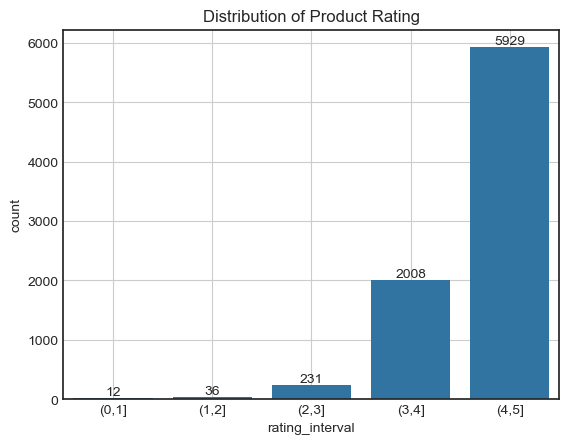

In [32]:
bins = [0, 1, 2, 3, 4, 5]
labels = ["(0,1]", "(1,2]", "(2,3]", "(3,4]", "(4,5]"]
product_df["rating_interval"] = pd.cut(product_df["rating"], bins=bins, right=True, labels=labels, include_lowest=False)

ax = sns.barplot(product_df["rating_interval"].value_counts().sort_index())
ax.bar_label(ax.containers[0], fontsize = 10)
ax.set_title('Distribution of Product Rating')
plt.grid(True)
plt.show()

Most of the products are at or above the average level. Let's also draw a suburst chart to explore the relation between `rating` and `First product category`, `Second product category` , `Third product category`.

In [33]:
df_plot = product_df[~ product_df['tertiary_category'].isna()] # the chart is not robust to na value

print('Number of rating NA value: ', product_df['tertiary_category'].isna().sum())

fig = px.sunburst(
    df_plot,
    path = ['primary_category', 'secondary_category', 'tertiary_category'],
    color = 'rating',
    maxdepth=-1,
    labels={'rating': 'Product Rating'}
)

fig.update_layout(
    width = 1200,
    height = 900,
    title={
        'text':"Proudct Category and Rating",
        'x': 0.47,
        'y': 0.95,
        'xanchor': 'center'
    },
    margin=dict(t=70)
)

fig.show()
#fig.write_html("my_sunburst_chart.html", include_plotlyjs=True)

Number of rating NA value:  990


Many sub-categories under Fragrance section show deep color, indicating significantly lower ratings compared to the bright orange/yellow. The users are more easily dissatisfied with Sephora's fragrance-type product offerings.

Skincare (such as "Moisturizers" and "Face Oils") is dominated by bright yellow and light orange hues, suggesting consistently high customer satisfaction. Makeup, fragrance, and hair show darker orange and reddish tones. This indicates while these categories have a massive product volume, it is more likely to receive lower ratings, whereas skincare serves as the reliable, high-quality backbone of the catalog.

After exploring the relation between product rating and category, how about the product price and product categories?

### 3.1.2 Price

In [34]:
fig = px.sunburst(
    df_plot,
    path = ['primary_category', 'secondary_category', 'tertiary_category'],
    color = 'price_usd',
    maxdepth=-1,
    labels={'price_usd': 'Product Price'}
)

fig.update_layout(
    width = 1200,
    height = 900,
    title={
        'text':"Proudct Category and Price",
        'x': 0.47,
        'y': 0.95,
        'xanchor': 'center'
    },
    margin=dict(t=70)
)

fig.show()

Notice that there is a very thin but distinct labeled "High Tech Tools" (and nearby "Anti-Aging") that appears bright yellow, this indicates while the majority of the category is affordable, this specific sub-category represents the premium price ceiling of Sephora’s inventory, standing out sharply against the rest of the dark purple chart.

The massive makeup section (eye, face, lip ...) is almost entirely deep purple, indicating a consistently low price point compared to other categories. Makeup unlike skincare or fragrance which have more price variation, has a low barrier to entry cost-wise, it is an accessible category.

By contrast, the overall fragrance section is colored in a lighter tone, indicating that the fragrance products generally sit in a "mid-to-high" price tier.

How about we summarise all the numerical variables in the product dataset?

### 3.1.3 All Numerical Features

In [35]:
df_plot = product_df[~product_df['reviews'].isna()]

fig = px.parallel_coordinates(
    df_plot.iloc[:,[4, 5, 6, 12]], 
    color="price_usd", 
    color_continuous_scale=px.colors.diverging.Spectral, 
    labels={'price_usd': 'Product Price'},
)

fig.update_layout(
    title={
        'text': "Product Price against Product Numeric Features",
        'x': 0.5,
        'y': 0.99,
        'xanchor': 'center'
    },
    margin=dict(t=80)
)

fig.show()

As the price peaks at the far right, the line dips to near zero on both the `reviews` and `loves_count` axes (blue line). There is a clear trade-off between price and engagement. Premium products (e.g. "high tech tools" category) generate almost no community buzz compared to the rest of the categories, likely due to low sales volume.

We see that the red lines (low price products) dominate the top peaks of the `loves_count` (reaching 1.4M+) and the `reviews` (reaching 20k+). This shows customers are in favor of cheaper products, the virality is exclusive to the lower price tier.

How about the non-numeric feature?

### 3.1.4 highlights

Highlights of a product recorded is a list of tags or features that highlight the product's attributes (e.g. [‘Vegan’, ‘Matte Finish’]).

We extract the top 20 most common keywords across all the highlights of products. Then compare their `rating`, `loves_count`, and `reviews`.

This envolves the creating of uni-gram. We will write a function for creating n-grams. 

Note: before generating the unigram, cleaned text is required, so we will also operate necessary text cleaning for the texts in `highlights` column. 

In [8]:
# create n gram
def generate_ngrams(text, n_gram=1):
    token = [token for token in text.lower().split(' ') if token != '' if token not in STOPWORDS]
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

In [37]:
df_highlights = product_df[~ product_df['highlights'].isna()].copy()

df_highlights['highlights_list'] = df_highlights['highlights'].apply(ast.literal_eval)
df_highlights['highlights_list'] = df_highlights['highlights_list'].apply(lambda x: ' '.join(x))

df_highlights['highlights_list'] = df_highlights['highlights_list'].str.replace(r'(?<!\w)-(?!\w)', ' ', regex=True)
df_highlights['highlights_list'] = df_highlights['highlights_list'].str.replace(r'[^\w\s-]', ' ', regex=True)
df_highlights['highlights_list'] = df_highlights['highlights_list'].str.strip()
df_highlights['highlights_list'] = df_highlights['highlights_list'].str.split()
df_highlights['highlights_list'] = df_highlights['highlights_list'].apply(lambda x: ' '.join(x))

df_highlights['unigram'] = df_highlights['highlights_list'].apply(lambda x: generate_ngrams(x, n_gram=1))

unigrams = defaultdict(int)

for row in df_highlights['unigram']:
    for word in row:
        unigrams[word] += 1

df_unigram = pd.DataFrame(sorted(unigrams.items(), key=lambda x: x[1])[::-1])

Plot the corresponding boxplots. 

Note: for `reviews` and `loves_count`, we apply $x \rightarrow log(1+x)$ transformation, otherwise the plots will be too skewed.

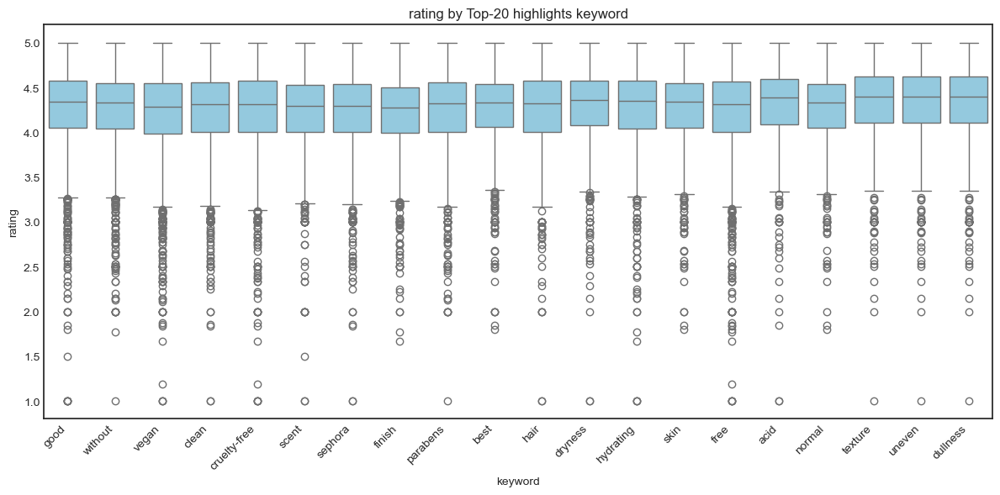

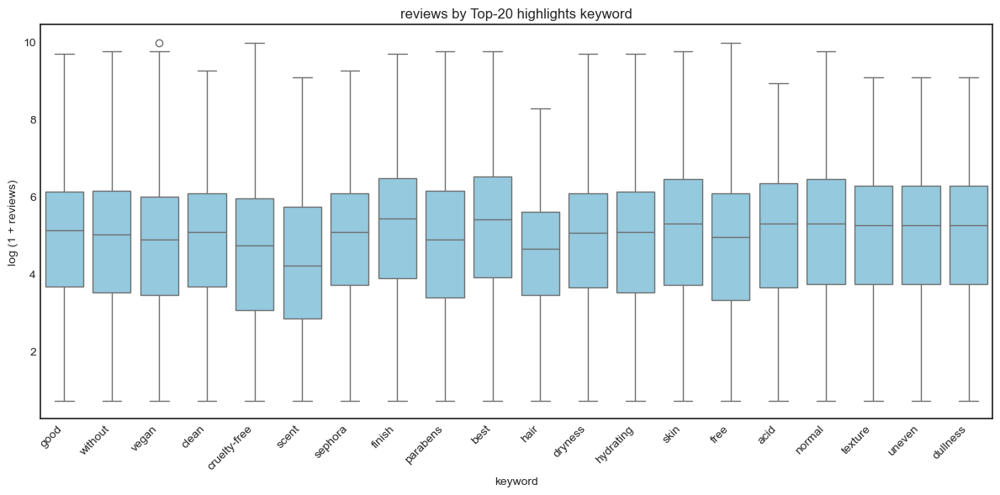

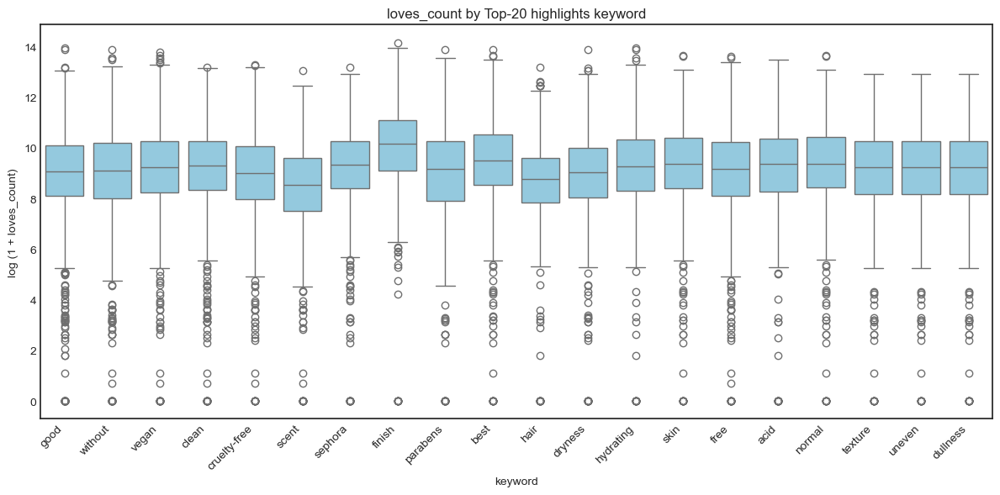

In [38]:
rows = list(df_unigram.loc[df_unigram.iloc[:, 1] >= 900, 0]) # Top 20
col_names = ["rating", "reviews", "loves_count"]

for col in col_names:
    plot_data = []
    for word in rows:
        sub = df_highlights[df_highlights["highlights_list"]
                            .str.contains(word, case=False, regex=False)][col]
        vals = np.log1p(sub) if col != "rating" else sub
        plot_data.append(pd.DataFrame({
            "word": word,
            col: vals
        }))
    plot_df = pd.concat(plot_data, ignore_index=True)

    plt.figure(figsize=(12, 6))
    sns.boxplot(data=plot_df, x="word", y=col, color="skyblue")
    plt.xticks(rotation=45, ha="right")
    plt.xlabel("keyword")
    plt.ylabel(col if col == "rating" else f"log (1 + {col})")
    plt.title(f"{col} by Top-20 highlights keyword")
    plt.tight_layout()
    plt.show()


Based on the 3 plots above, there is no much variation across the keywords, highlight keyword is not the sole factor impacting the numercial metrics here.

## 3.2 Review Level

First, how many customers posted at least 1 review?

In [39]:
print('Unique customers: ', len(review_df_all_deduplicate['author_id'].unique()))

Unique customers:  432578


Then, what does the time interval between posted reviews look like?

### 3.2.1 Time Range

In [40]:
review_df_all_deduplicate['submission_year'] = pd.to_datetime(review_df_all_deduplicate['submission_time']).dt.year
review_df_all_deduplicate['submission_month'] = pd.to_datetime(review_df_all_deduplicate['submission_time']).dt.month

plot_data = review_df_all_deduplicate.loc[:, ['submission_year', 'submission_month']]
plot_data = plot_data.groupby(["submission_year", "submission_month"]).size().reset_index(name="count")

fig = px.sunburst(
    plot_data,
    path=["submission_year", "submission_month"],
    values="count",
    color="count",
    color_continuous_scale="YlOrRd",
    labels={"count": "Reviews Count by Month"},
)

fig.update_layout(
    width = 1200,
    height = 900,
    title={
        'text':"Reviews Count",
        'x': 0.47,
        'y': 0.95,
        'xanchor': 'center'
    },
    margin=dict(t=70)
)

fig.show()

*Note: ignore the color presentation (difference) in the middle pie chart.*

The reviews span from 2008 to 2023. Among these years, 2020, 2021, and 2022 account for a large proportion of the reviews. In addition, reviews peak in January, April, May, and August during these years.

Since we are dealing with unstructured text data, N-gram analysis is essential to capture recurring phrase patterns and understand the linguistic structure of the reviews.

### 3.2.2 N-Gram Analysis

Create dataframe containing n-grams needed, we will be exploring unigram, bigram, and trigram.

In [41]:
df_gram = review_df_all_deduplicate.copy()
df_gram = df_gram[['author_id','review_id','review_text']]

# unigram
df_gram['unigram'] = review_df_all_deduplicate['review_text'].apply(lambda x: generate_ngrams(x, n_gram=1))
# bigram
df_gram['bigram'] = review_df_all_deduplicate['review_text'].apply(lambda x: generate_ngrams(x, n_gram=2))
# trigram
df_gram['trigram'] = review_df_all_deduplicate['review_text'].apply(lambda x: generate_ngrams(x, n_gram=3))

#### Unigram

Most common unigrams are mostly stop words and uncleand words (with punctuations), which do not contain much information, this indicates we need further cleaning.

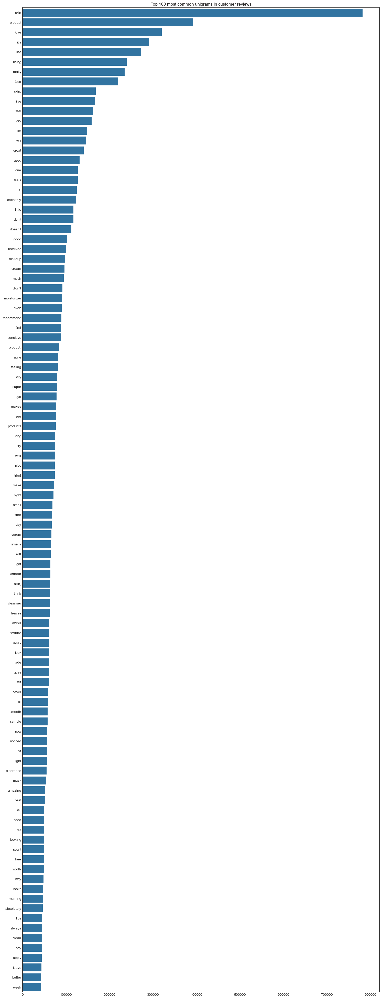

In [42]:
unigrams = defaultdict(int)

for row in df_gram['unigram']:
    for word in row:
        unigrams[word] += 1

df_unigram = pd.DataFrame(sorted(unigrams.items(), key=lambda x: x[1])[::-1])

fig, ax = plt.subplots(figsize=(18, 50), dpi=100)
N = 100
sns.barplot(y = df_unigram[0][:N], x=df_unigram[1][:N])

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_title('Top 100 most common unigrams in customer reviews')
plt.show()

#### Bigram

Bigrams reveal more information than the unigrams, the most common bigrams are about skin, deatiled information about customer skin is shown, for instance, we see 'dry skin' and 'sensitive skin' are mentioned very frequently. And we can infer that people who bought skincare products are likely to leave a comment.

But most bigrams still contain stop words and uncleand words (with punctuations), we need further cleaning.

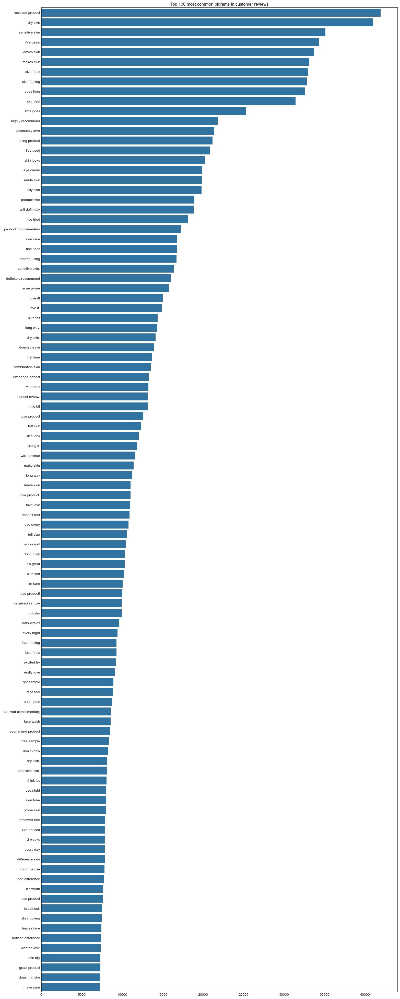

In [43]:
bigrams = defaultdict(int)

for row in df_gram['bigram']:
    for word in row:
        bigrams[word] += 1

df_bigram = pd.DataFrame(sorted(bigrams.items(), key=lambda x: x[1])[::-1])

fig, ax = plt.subplots(figsize=(18, 50), dpi=100)

sns.barplot(y = df_bigram[0][:N], x=df_bigram[1][:N])

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_title('Top 100 most common bigrams in customer reviews')
plt.show()

#### Trigram

Most common trigrams are also about skin, from the most common trigram we see customers care long-lasting effects of the prodcuts.

The same stop words and uncleand words issues exist in this plot, we need further cleaning.

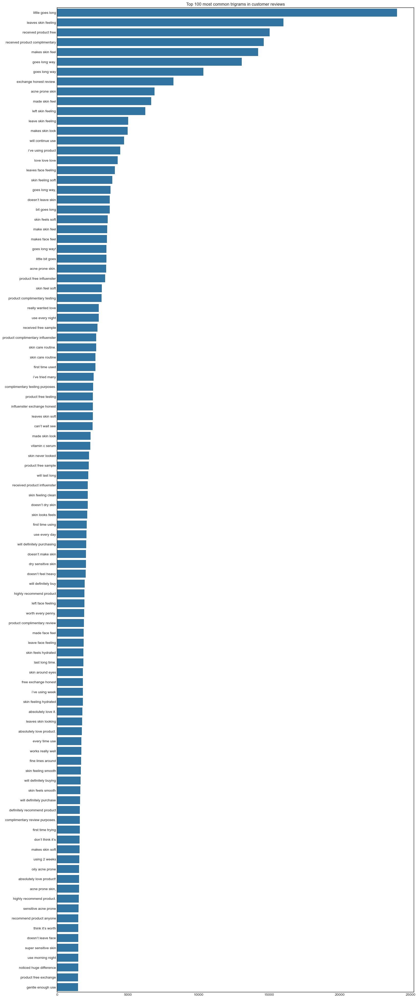

In [44]:
trigrams = defaultdict(int)

for row in df_gram['trigram']:
    for word in row:
        trigrams[word] += 1

df_trigram = pd.DataFrame(sorted(trigrams.items(), key=lambda x: x[1])[::-1])

fig, ax = plt.subplots(figsize=(18, 50), dpi=100)

sns.barplot(y = df_trigram[0][:N], x=df_trigram[1][:N])

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_title('Top 100 most common trigrams in customer reviews')
plt.show()

This is enough for EDA, now as the above N-Gram analysis indicated, we proceed to clean texts before word embedding.

# 4. Text Cleaning

## 4.1 Language Detection

This dataset contains multiple language product reviews, examples are Spanish, French, Chinese, and etc., so our first thing to do is to detect English-only reviews.

We will use two language detection tools: `langdetect` and `langid`, the first one will do the detection work, and the second one will validate the detection results. Detailed scripts are omitted for brevity, interesting reader can find it [here](https://github.com/yuu1zhou/Clustering-with-Sephora-Product-Reviews/blob/main/language_detection.ipynb). 

Here we directly import the processed dataset.

In [45]:
review_df_all_deduplicate = pd.read_csv("dataset/review_df_all_deduplicate_english.csv", index_col = 0)

## 4.2 Lowercase Letter

In [46]:
review_df_all_deduplicate['review_text'] = review_df_all_deduplicate['review_text'].str.lower()

## 4.3 Standardize Unicode Character

After detecting the non-English reviews, there are other unicode variation of standard punctuation marks,e.g. '！' $\rightarrow$ '!', we clean them by mapping them to standard English punctuation characters. 

We first use `unicodedata` library to systematically normalize the variation, then utilize LLM to detect remaining variation and list the corresponding character mapping, the detail of using LLM is ommited.

In [47]:
def clean_unicode(text):
    text = unicodedata.normalize('NFKC', text)

    return text

def detect_anomalies(text):
    anomalies = []
    for char in text:
        cp = ord(char)
        # unicode point for ASCII (0-127) 
        if cp < 128:
            continue
            
        category = unicodedata.category(char)
        # category of unicode: Punctuation, other (PO)
        if category in ['Po']:
            anomalies.append(f"{char}") # ({hex(cp)})
            
    return ",".join(anomalies) if anomalies else None

review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text'].map(clean_unicode)

In [48]:
a = review_df_all_deduplicate['review_text_cleaned'].apply(detect_anomalies)
# export for LLM to detect
a[a.notna()].to_csv('dataset/special_punctuation.csv', encoding="utf-8-sig", index=True)

In [49]:
def clean_unicode(text):
    punctuation_map = {
        '。': '.',        
        '、': ',',   
        '·': '.',         
        '・': '.',       
        '¡': '!',      
        '¿': '?',        
        '،': ',',  
        }
    
    unmappable_symbols = ['•', '⁃']

    for old, new in punctuation_map.items():
        text = re.sub(old, new, text)

    for char in unmappable_symbols:
        text = re.sub(char, ' ', text)

    return text

review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].map(clean_unicode)

## 4.4 Non-ASCII Character

This is similar to unicode cleaning, here we will remove those unmeaningful non-ASCII characters. 

Non-ASCII characters are such as non-English characters 'å', emojis '🙂', and the characters that cannot be displayed '\u2028'. However, we will only remain emojis, since the later embedding model can identify and convert emojis to correct numerical vectors.

In [50]:
# English letters + number + ASCII punctuation
ascii_allowed = r"[A-Za-z0-9\s\.,!?;:'\"()\-\[\]{}]"

emoji_pattern = (
    r"[\U0001F1E0-\U0001F1FF"  # Flags
    r"\U0001F300-\U0001F5FF"   # Symbols & pictographs
    r"\U0001F600-\U0001F64F"   # Emoticons
    r"\U0001F680-\U0001F6FF"   # Transport & map symbols
    r"\U0001F700-\U0001F77F"   # Alchemical symbols
    r"\U0001F780-\U0001F7FF"   # Geometric symbols
    r"\U0001F800-\U0001F8FF"   # Supplemental arrows
    r"\U0001F900-\U0001F9FF"   # Supplemental symbols & pictographs
    r"\U0001FA00-\U0001FA6F"   # Chess, symbols
    r"\U0001FA70-\U0001FAFF"   # Emoji components
    r"\U00002702-\U000027B0"   # Dingbats
    r"\U000024C2-\U0001F251"   # Enclosed characters
 r"]"
)

allowed = f"(?:{ascii_allowed}|{emoji_pattern})"

def clean_text_keep_emoji(text):
    return "".join(char if re.match(allowed, char) else "" for char in text)

review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].apply(lambda x: clean_text_keep_emoji(x))

In [51]:
punc_lis_remain = []

for text in review_df_all_deduplicate['review_text_cleaned']:
    punc_lis_remain.extend(re.findall(r"[^\w\s]", text))

punc_lis_remain = sorted(set(punc_lis_remain), key=lambda ch: ord(ch))
punc_lis_remain = [p for p in punc_lis_remain if not p.isascii()]

print('Non-ASCII characters remained: ', punc_lis_remain)

Non-ASCII characters remained:  ['─', '╥', '■', '▪', '▫', '▰', '▶', '◇', '◡', '◼', '☀', '☁', '★', '☆', '☝', '☬', '☹', '☺', '♀', '♂', '♡', '♥', '♻', '♾', '⚗', '⚜', '⚠', '⚡', '⚪', '⛅', '⛑', '✅', '✈', '✋', '✌', '✓', '✔', '✖', '✦', '✨', '✳', '❄', '❌', '❕', '❗', '❣', '❤', '➕', '➖', '➡', '➾', '➿', '⠀', '⬇', '⭐', '〈', '《', '》', '〜', '〰', '\uf04c', '\uf0a7', '︅', '︎', '️', '\ufeff', '￼', '�', '🅶', '🅷', '🅼', '🅾', '🆂', '🆃', '🆄', '🆈', '🆓', '🆙', '🌊', '🌙', '🌞', '🌟', '🌫', '🌱', '🌸', '🌹', '🌺', '🌿', '🍂', '🍃', '🍅', '🍉', '🍊', '🍋', '🍌', '🍒', '🍓', '🍞', '🍬', '🍯', '🎀', '🎄', '🎉', '🏆', '🏻', '🏼', '🏽', '🏾', '🐐', '🐘', '🐝', '🐣', '👀', '👁', '👄', '👋', '👌', '👍', '👎', '👏', '👣', '👩', '👶', '💀', '💄', '💅', '💋', '💓', '💔', '💕', '💖', '💗', '💘', '💙', '💚', '💛', '💜', '💞', '💡', '💥', '💦', '💨', '💫', '💯', '📌', '📍', '📦', '🔥', '🔵', '🖤', '😀', '😁', '😂', '😃', '😄', '😅', '😆', '😉', '😊', '😌', '😍', '😏', '😒', '😓', '😔', '😕', '😖', '😘', '😚', '😝', '😞', '😠', '😢', '😩', '😪', '😫', '😬', '😭', '😮', '😲', '😳', '😶', '😻', '🙁', '🙂', '🙃', '🙄', '🙌', '🙏', '🛍', '🛑

In [52]:
non_emoji_list = ['─', '╥', '■', '▪', '▫', '▰', '▶', '◇', '◡', '◼', 
                  '〈', '《', '》', '〜', '〰', 
                  '✦', '✳', '⠀', '︅', '︎', '️', '\ufeff', '￼', '\uf04c', '\uf0a7']

pat = "[" + re.escape("".join(non_emoji_list)) + "]"
review_df_all_deduplicate["review_text_cleaned"] = review_df_all_deduplicate["review_text_cleaned"].str.replace(pat, "", regex=True)

punc_lis_remain = []
for text in review_df_all_deduplicate['review_text_cleaned']:
    punc_lis_remain.extend(re.findall(r"[^\w\s]", text))

punc_lis_remain = sorted(set(punc_lis_remain), key=lambda ch: ord(ch))
punc_lis_remain = [p for p in punc_lis_remain if not p.isascii()]

print('Non-ASCII characters remained after cleaning: ', punc_lis_remain)

Non-ASCII characters remained after cleaning:  ['☀', '☁', '★', '☆', '☝', '☬', '☹', '☺', '♀', '♂', '♡', '♥', '♻', '♾', '⚗', '⚜', '⚠', '⚡', '⚪', '⛅', '⛑', '✅', '✈', '✋', '✌', '✓', '✔', '✖', '✨', '❄', '❌', '❕', '❗', '❣', '❤', '➕', '➖', '➡', '➾', '➿', '⬇', '⭐', '�', '🅶', '🅷', '🅼', '🅾', '🆂', '🆃', '🆄', '🆈', '🆓', '🆙', '🌊', '🌙', '🌞', '🌟', '🌫', '🌱', '🌸', '🌹', '🌺', '🌿', '🍂', '🍃', '🍅', '🍉', '🍊', '🍋', '🍌', '🍒', '🍓', '🍞', '🍬', '🍯', '🎀', '🎄', '🎉', '🏆', '🏻', '🏼', '🏽', '🏾', '🐐', '🐘', '🐝', '🐣', '👀', '👁', '👄', '👋', '👌', '👍', '👎', '👏', '👣', '👩', '👶', '💀', '💄', '💅', '💋', '💓', '💔', '💕', '💖', '💗', '💘', '💙', '💚', '💛', '💜', '💞', '💡', '💥', '💦', '💨', '💫', '💯', '📌', '📍', '📦', '🔥', '🔵', '🖤', '😀', '😁', '😂', '😃', '😄', '😅', '😆', '😉', '😊', '😌', '😍', '😏', '😒', '😓', '😔', '😕', '😖', '😘', '😚', '😝', '😞', '😠', '😢', '😩', '😪', '😫', '😬', '😭', '😮', '😲', '😳', '😶', '😻', '🙁', '🙂', '🙃', '🙄', '🙌', '🙏', '🛍', '🛑', '🛒', '🤌', '🤍', '🤎', '🤐', '🤓', '🤔', '🤗', '🤞', '🤡', '🤢', '🤣', '🤤', '🤦', '🤨', '🤩', '🤪', '🤭', '🤮', '🤯', '🤷', '🥑', '🥰', '🥲', '🥳

## 4.5 Abbreviation

Two types of abbreviation:

1. Contraction e.g.: i've and don't, ...

2. Abbreviation: 

   - slang/Internet slang, e.g.: idk, lol, omg, ...
   
   - specific terms, e.g: aha, bha, ...


For type 1:

We detect 0.

In [53]:
# previous n gram generator function, we slightly fix condition, don't let stopwords removed
def generate_ngrams_1(text, n_gram=1):
    token = [token for token in text.lower().split(' ') if token != '']
    ngrams = zip(*[token[i:] for i in range(n_gram)])
    return [' '.join(ngram) for ngram in ngrams]

In [54]:
df_gram_abbreviation = pd.DataFrame(review_df_all_deduplicate['review_text_cleaned'])
df_gram_abbreviation['unigram'] = df_gram_abbreviation['review_text_cleaned'].apply(lambda x: generate_ngrams_1(x, n_gram=1))

all_tokens = (tok for lst in df_gram_abbreviation["unigram"] for tok in lst)

pattern = re.compile(r"[']")
abbr_tokens = [t for t in all_tokens if pattern.search(t)]

print('Number of tokens that contain \': ', len(abbr_tokens))

Number of tokens that contain ':  0


For type 2:

In [55]:
df_gram_abbreviation = pd.DataFrame(review_df_all_deduplicate['review_text_cleaned'])
df_gram_abbreviation['unigram'] = df_gram_abbreviation['review_text_cleaned'].apply(lambda x: generate_ngrams(x, n_gram=1))

all_tokens = (tok for lst in df_gram_abbreviation["unigram"] for tok in lst)
short_tokens = [t for t in all_tokens if len(t) < 4]
short_freq = Counter(short_tokens)

print('Top 300 frequent abbreviation: ')
# top 300
short_freq.most_common(300) 

Top 300 frequent abbreviation: 


[('use', 272304),
 ('ive', 171096),
 ('dry', 159353),
 ('im', 154930),
 ('one', 127205),
 ('it.', 124566),
 ('eye', 78190),
 ('see', 77121),
 ('try', 74632),
 ('day', 67153),
 ('got', 64184),
 ('oil', 59045),
 ('now', 57219),
 ('bit', 56869),
 ('put', 49486),
 ('way', 48134),
 ('say', 44528),
 ('me.', 42047),
 ('-', 41424),
 ('it!', 41128),
 ('lot', 40673),
 ('new', 40599),
 ('lip', 40348),
 ('go', 40282),
 ('buy', 39846),
 ('it,', 34403),
 ('two', 32847),
 ('2', 31272),
 ('3', 25486),
 ('far', 24733),
 ('bad', 22231),
 ('ill', 21496),
 ('id', 19492),
 ('job', 18429),
 ('gel', 18352),
 ('big', 17864),
 ('top', 17829),
 ('.', 17445),
 ('saw', 17114),
 ('may', 16945),
 ('red', 16641),
 ('spf', 16066),
 ('c', 15669),
 ('5', 15594),
 ('fan', 15298),
 ('yet', 15091),
 ('4', 14276),
 ('up.', 13624),
 ('let', 13066),
 ('end', 12823),
 ('add', 12805),
 ('due', 12034),
 ('me,', 11942),
 ('on.', 11419),
 ('!', 11052),
 ('rid', 10846),
 ('sun', 10810),
 ('jar', 10609),
 ('(i', 10440),
 (',', 9992

We standardized abbreviations by examining the top 300 most frequent tokens with a length of less than 4 characters. While these thresholds (Top-300, Length < 4) are heuristic, this approach effectively captures the majority of high-frequency cases without requiring exhaustive manual review.

Create correction mapping.

In [56]:
correct_map = {
    r"\bive\b": "i have",
    r"\bim\b": "i am",
    r"\bill\b": "i will",
    r"\bspf\b": "sun protection factor",
    r"\bbc\b": "because",
    r"\bdr\.\b": "doctor",
    r"\bdr\b": "doctor",
    r"\bdef\b": "definitely",
    r"\bptr\b": "peter thomas roth",
    r"\bbha\b": "beta hydroxy acid",
    r"\baha\b": "alpha hydroxy acid",
    r"\bbb\b": "beauty balm",
    r"\bha\b": "hyaluronic acid",
    r"\bomg\b": "oh my god",
    r"\blol\b": "laugh out loud",
    r"\bidk\b": "i do not know",
    r"\bur\b": "your",
    r"\btho\b": "though",
    r"\bfav\b": "favorite",
    r"\bceo\b": "sunday riley",
    r"\bhg\b": "holy grail",
    r"\betc\b": "et cetera",
    r"\bvib\b": "very important beauty insider",
    r"\bmin\b": "minutes",
    r"\bph\b": "potential of hydrogen",
    r"\bmeh\b": "eh",
    r"\bfab\b": "first aid beauty",
    r"\buv\b": "ultraviolet",
    r"\bitd\b": "it would",
    r"\bcuz\b": "because",
    r"\bvit\b": "vitamin",
    r"\b30s\b": "30 seconds",
    r"\b20s\b": "20 seconds",
    r"\b40s\b": "40 seconds",
    r"\b1st\b": "first",
    r"\b2nd\b": "second",
    r"\b3rd\b": "third",
    r"\b4th\b": "fourth",
    r"\b3x\b": "3 times",
    r"\blil\b": "little",
    
    # latter added
    r"\bwouldnt\b": "would not",
    r"\bhavec\b": "have",
    r"\bbomb.com\b": "great",
    r"\byrs\b": "years",
    r"\bfyi\b": "for your information",
    r"\brn\b": "right now",
    r"\bsoo\b": "so",
    r"\bgonna\b": "going to",
    r"\byoull\b": "you will",

    r"(?<=\s)\(im(?=\s)": "i am",
    r"(?<=\s)\(if(?=\s)": "if",
    r"(?<=\s)\(no(?=\s)": "no",
    r"(?:(?<=\s)|^)\bit\)(?=\s|$)": "it",
    r"(?:(?<=\s)|^)\bme\)(?=\s|$)": "me",
    r"(?<=\s)\(so(?=\s)": "so",
}

review_df_all_deduplicate['review_text_cleaned'] = (
    review_df_all_deduplicate['review_text_cleaned']
    .replace(correct_map,regex=True)
)

Specifically fix 'ii' abbrevation.

'ii' could be typo of 'i', and also could be the product name 'sk-ii'.

In [57]:
COMMON_VERBS_AFTER_I = {
    "love","like","think","use","used","feel","felt","have","had","am",
    "would","will","wish","want","tried","try","bought","buy",
    "recommend","ordered","order","see","saw","noticed","notice",
    "find","found","hate","dislike","prefer","need","needed",

    # latter added
    "mean", "only", "also", "heard", 
}

def fix_ii_typos(text):

    tokens = text.split()
    new_tokens = []

    for idx, tok in enumerate(tokens):
        lower_tok = tok.lower()

        if lower_tok == "ii":
            prev_tok = tokens[idx-1].lower() if idx > 0 else ""
            next_tok = tokens[idx+1].lower() if idx+1 < len(tokens) else ""

            if prev_tok.isdigit():
                new_tokens.append(tok)

            elif next_tok in COMMON_VERBS_AFTER_I:

                new_tokens.append("i")
            else:

                new_tokens.append(tok)
        else:
            new_tokens.append(tok)

    return " ".join(new_tokens)

mask = review_df_all_deduplicate['review_text_cleaned'].str.contains(r'\bii\b', regex=True)
review_df_all_deduplicate.loc[mask, 'review_text_cleaned'] = review_df_all_deduplicate.loc[mask, 'review_text_cleaned'].apply(fix_ii_typos)

## 4.6 URL

Clean urls in reviews.

In [58]:
def clean_URL(text):
    url = re.compile(r'https?://\S+|www\.\S+|\bhttps?\b') # enhanced, remove residual 'http'
    
    return url.sub('',text).strip()

review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].map(clean_URL)
review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].str.replace(r"\b[\w.-]+\.com\b", "", regex=True)

## 4.7 Letter Repeat

Clean the words that contain multiple repeated letters. (e.g., loooooooove, soooooooo ...)

1. reduce any character sequence exceeding a length of 3 down to 2 characters to restore standard spelling.

2. Find and analyze the top 500 most frequent words containing repeated characters to identify and handle remaining irregularities.

In [59]:
mask = review_df_all_deduplicate['review_text_cleaned'].str.contains(r"([A-Za-z])\1{2,}", regex=True)


review_df_all_deduplicate.loc[mask, 'review_text_cleaned'] = (
    review_df_all_deduplicate.loc[mask, 'review_text_cleaned']
    .str.replace(r"([A-Za-z])\1{2,}", r"\1\1", regex=True)
)

C:\Users\fuyuz\AppData\Local\Temp\ipykernel_32064\277250214.py:1: UserWarning:

This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.



In [60]:
df_gram_repeat = review_df_all_deduplicate.loc[mask, 'review_text_cleaned'].copy()
df_gram_repeat = pd.DataFrame(df_gram_repeat)
df_gram_repeat['unigram'] = df_gram_repeat['review_text_cleaned'].apply(lambda x: generate_ngrams(x, n_gram=1))

In [61]:
all_tokens = (tok for lst in df_gram_repeat["unigram"] for tok in lst)

short_tokens = [t for t in all_tokens if re.search(r"([A-Za-z])\1", t)] 
short_freq = Counter(short_tokens)

print('Top 500 frequent words with repeated letter: ')

# top 500
short_freq.most_common(500)

Top 500 frequent words with repeated letter: 


[('soo', 7964),
 ('really', 5194),
 ('will', 4676),
 ('feel', 3779),
 ('little', 3375),
 ('feels', 3206),
 ('good', 2891),
 ('smells', 2337),
 ('recommend', 1877),
 ('look', 1801),
 ('smell', 1734),
 ('feeling', 1667),
 ('see', 1619),
 ('well', 1548),
 ('smooth', 1532),
 ('still', 1418),
 ('need', 1384),
 ('stuff', 1285),
 ('looks', 1284),
 ('looking', 1239),
 ('actually', 1159),
 ('better', 1113),
 ('week', 1050),
 ('lovee', 1028),
 ('apply', 1025),
 ('full', 1019),
 ('pretty', 1004),
 ('difference', 996),
 ('bottle', 951),
 ('free', 930),
 ('loove', 914),
 ('weeks', 813),
 ('literally', 812),
 ('less', 796),
 ('happy', 768),
 ('keep', 755),
 ('usually', 743),
 ('looked', 736),
 ('getting', 697),
 ('small', 690),
 ('redness', 662),
 ('sunscreen', 644),
 ('especially', 601),
 ('all.', 599),
 ('good.', 586),
 ('different', 559),
 ('well.', 528),
 ('tell', 519),
 ('applying', 495),
 ('good!', 481),
 ('took', 461),
 ('finally', 446),
 ('totally', 420),
 ('applied', 402),
 ('loong', 398),


Create correction mapping.

In [62]:
correct_map_1 = {
    r"\bsoo\b": "so",
    r"\bsooo\b": "so",
    r"\bsoooo\b": "so",
    r"\bsooooo\b": "so",

    r"\blovee\b": "love",
    r"\bloove\b": "love",
    r"\bloong\b": "long",
    r"\bwayy\b": "way",
    r"\bgonna\b": "going to",
    r"\bwaay\b": "way",
    r"\bsuuper\b": "super",
    r"\byttp\b": "youth to the people",
    r"\byoull\b": "you will",
    r"\blongg\b": "long",
    r"\bnighttime\b": "night time",    
    r"\bitll\b": "it will",
    r"\breallyy\b": "really", 
    r"\bwanna\b": "want to", 
    r"\bohh\b": " ", 
    r"\bbuut\b": "but", 
    r"\byall\b": "you all",
    r"\bloovvee\b": "love",    
    r"\blovee\.": "love",      
    r"\bamazingg\b": "amazing",       
    r"\bwoww\b": "wow",     
    r"\bsuperr\b": "super",
    r"\baand\b": "and",
    r"\bamazingg\.": "amazing", 
    r"\bnoo\b": "no", 
    r"\bgotta\b": "got to", 
    r"\bdeff\b": "definitely", 
    r"\bveryy\b": "very", 
    r"\bandd\b": "and",
    r"\bomgg\b": "oh my god",
    r"\bloove\.": "love",
    r"\bloovee\b": "love",
    r"\blooved\b": "loved",
    r"\byess\b": "yes",
    r"\byall,": "you all",
    r"\bhuuge\b": "huge",
    r"\byess!": "yes",
    r"\blovvee\b": "love",
    r"\bwaayy\b": "way",
    r"\bloove!\b": "love",
    r"\bbutt\b": "but",
    r"\bloonngg\b": "long",
    r"\bitt\.": "it",
    r"\bforeverr\b": "forever",
    r"\bthicc\b": "thick",
    r"\bverry\b": "very",
    r"\bitt\b": "it",
    r"\blonng\b": "long",
    r"\beverr\b": "ever",
    r"\booh\b": " ", 
    r"\blovedd\b": "loved",
    r"\blott\b": "lot",
    r"\bsoo,": "so",
    r"\bmuchh\b": "much",
    r"\byess!!!": "yes",
    r"\bwoow\b": " ",
    r"\blooves\b": "loves",
    r"\byall\.": "you all",
    r"\bitt!": "it",
    r"\breaally\b": "really",
    r"\bamaazing\.": "amazing", 
    r"\bverryy\b": "very",
    r"\bhella\b": "very",
    r"\bamazingg!": "amazing", 
    r"\bloovvee\b": "love",

    # later added
    r"\bahh\b": " ", 
    r"\bumm\b": " ",     
    r"\blovee!": "love",
    r"\byess\b": "yes",
    r"\bhmm\b": " ", 
    r"\bcombooily\b": "combo oily", 
    r"\blovve\b": "love",   
    r"\behh\b": " ",  
    r"\bloonngg\b": "long",    
    r"\bhugee\b": "huge",  
    r"\bfreeproduct\b": "free product",    
    r"\bandd\b": "and",
    r"\byess!": "yes",
    r"\blott\b": "lot",
}

review_df_all_deduplicate['review_text_cleaned'] = (
    review_df_all_deduplicate['review_text_cleaned']
    .replace(correct_map_1,regex=True)
)

## 4.8 Punctuation

Remove punctuations.

In [63]:
pattern = "[" + re.escape(string.punctuation) + "]" 
review_df_all_deduplicate["review_text_cleaned"] = (
    review_df_all_deduplicate["review_text_cleaned"].str.replace(pattern, " ", regex=True)
)

punc_lis_remain = []

for text in review_df_all_deduplicate['review_text_cleaned']:
    punc_lis_remain.extend(re.findall(r"[^\w\s]", text))

punc_lis_remain = sorted(set(punc_lis_remain), key=lambda ch: ord(ch)) 
print('Characters (only emoji) left in the reviews: ', '\n', punc_lis_remain)

Characters (only emoji) left in the reviews:  
 ['☀', '☁', '★', '☆', '☝', '☬', '☹', '☺', '♀', '♂', '♡', '♥', '♻', '♾', '⚗', '⚜', '⚠', '⚡', '⚪', '⛅', '⛑', '✅', '✈', '✋', '✌', '✓', '✔', '✖', '✨', '❄', '❌', '❕', '❗', '❣', '❤', '➕', '➖', '➡', '➾', '➿', '⬇', '⭐', '�', '🅶', '🅷', '🅼', '🅾', '🆂', '🆃', '🆄', '🆈', '🆓', '🆙', '🌊', '🌙', '🌞', '🌟', '🌫', '🌱', '🌸', '🌹', '🌺', '🌿', '🍂', '🍃', '🍅', '🍉', '🍊', '🍋', '🍌', '🍒', '🍓', '🍞', '🍬', '🍯', '🎀', '🎄', '🎉', '🏆', '🏻', '🏼', '🏽', '🏾', '🐐', '🐘', '🐝', '🐣', '👀', '👁', '👄', '👋', '👌', '👍', '👎', '👏', '👣', '👩', '👶', '💀', '💄', '💅', '💋', '💓', '💔', '💕', '💖', '💗', '💘', '💙', '💚', '💛', '💜', '💞', '💡', '💥', '💦', '💨', '💫', '💯', '📌', '📍', '📦', '🔥', '🔵', '🖤', '😀', '😁', '😂', '😃', '😄', '😅', '😆', '😉', '😊', '😌', '😍', '😏', '😒', '😓', '😔', '😕', '😖', '😘', '😚', '😝', '😞', '😠', '😢', '😩', '😪', '😫', '😬', '😭', '😮', '😲', '😳', '😶', '😻', '🙁', '🙂', '🙃', '🙄', '🙌', '🙏', '🛍', '🛑', '🛒', '🤌', '🤍', '🤎', '🤐', '🤓', '🤔', '🤗', '🤞', '🤡', '🤢', '🤣', '🤤', '🤦', '🤨', '🤩', '🤪', '🤭', '🤮', '🤯', '🤷', '🥑', '🥰', '🥲', '

## 4.9 Random Words

Finally, notice the existence of random and meaningless words that have extremely long length, for example:

In [64]:
review_df_all_deduplicate.loc[80989, 'review_text_cleaned']

'yea i agree yes same mhm jtssngdbkgiiycycitctiheckljjioo'

We applied a heuristic threshold of 23 characters, any individual token exceeding this limit was identified as an anomaly and removed.

In [65]:
def detect_gibberish(w, min_len = 30):    
    if len(w) > min_len:
        return True

    return False

def gibberish_text(text):
    words = text.split()
    return any(detect_gibberish(w) for w in words)


mask = review_df_all_deduplicate['review_text_cleaned'].apply(gibberish_text)

df_process = review_df_all_deduplicate.loc[mask, 'review_text_cleaned']
df_process = pd.DataFrame(df_process)

def drop_long_word(text, threshold = 23):
    emoji = {"✅", "❌"} 
    tokens = text.split()
    kept = []

    for tok in tokens:
        if len(tok) >= threshold:
            if any(e in tok for e in emoji):
                kept.append(tok)

        else:
            kept.append(tok)

    return " ".join(kept)


df_process['review_text_cleaned'] = df_process['review_text_cleaned'].apply(drop_long_word)
review_df_all_deduplicate.loc[df_process.index, 'review_text_cleaned'] = df_process['review_text_cleaned']

This concludes our text cleaning pipeline. While achieving a perfectly clean corpus is impractical given the large volume of unstructured text, this process has substantially reduced noise and standardized the data.

In [66]:
review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].str.replace(r"\s+", " ", regex=True)
review_df_all_deduplicate['review_text_cleaned'] = review_df_all_deduplicate['review_text_cleaned'].str.strip()

In [67]:
# some text entries are empty after cleaning, we remove them
idx_length_0 = review_df_all_deduplicate[review_df_all_deduplicate['review_text_cleaned'].map(len) == 0].index

mask = np.isin(review_df_all_deduplicate.index, idx_length_0)

review_df_all_deduplicate = review_df_all_deduplicate.loc[review_df_all_deduplicate.index.values[~ mask]]

The actual texts to be clustered will be within recent 4 years, the past comments over 4 years would be too outdated to current product development, and therefore they are considered as noise.

In [68]:
review_df_all_deduplicate = review_df_all_deduplicate[review_df_all_deduplicate['submission_year'] >= 2020]
review_df_all_deduplicate.to_csv('dataset/review_df_all_deduplicate_processed.csv', index=True)

# 5. Sentence Embedding

We use Sentence-BERT to generate sentence embeddings. Unlike traditional keyword-based methods (e.g. TF-IDF) or static embeddings (e.g. Fasttext), SBERT captures deep contextual meaning. For instance, it understands that "not good" is the opposite of "good," whereas keyword-based models might treat them similarly. Therefore it is the most suitable model to precisely convert sentences into vectors given our current computational resources and data.

The implementation details are omitted for brevity. Since this model is a transformer-based model that benefits significantly from GPU acceleration, the full execution script is hosted on Google Colab and can be found [here](https://colab.research.google.com/drive/1LzHvIFuf3cqDMzEC-q4iPwFKgljSERYl).

We directly import the transformed vectors.

In [69]:
df_sbert = pd.read_csv("dataset/sbert_embeddings_2.csv", index_col=0)

# 6. Clustering

Given our dataset size of over 800,000 reviews, performing t-SNE to firstly visualize clustering structure of the dataset is computationally prohibitive, we use UMAP instead, since:

1. UMAP is much faster especially on large datasets.

2. UMAP better maintains the relationships between clusters, not just points within clusters, offering a more accurate representation of the high-dimensional data's overall shape.

### 6.1 UMAP

We first draw a set of UMAP plots with different combinations of `n_neighbors` and `min_dist` to avoid instability caused by parameters. Candidate values are `n_neighbors` = 15, 30, 45, 60, and `min_dist` = 0.1.

Notice here we choose `init = 'pca'` and `metric = 'cosine'`. The PCA initialization provides a deterministic, linear foundation that prevents the broad global layout of the dataset, it prevents from the default spectral initialization failed warnings often encounterd with dense, complex sentece manifolds, and by starting from a PCA projection, UMAP organizes more effectively the large-scale semantic clouds before refining the local neighborhood connectivity. SBERT embeddings are specifically trained to represent semantic similarity through angular relationships in high-dimensional space, the cosine metric focuses solely on the orientation of the vectors, which is different from Euclidean distance accounting for vector magnitude (often affected by sentence length or token frequency) and captures the core semantic intent, therefore the metric is an ideal fit to our case.

n_neighbors = 15, min_dist = 0.1.

In [70]:
umap = UMAP(n_neighbors=15, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap = umap.fit_transform(df_sbert)

n_neighbors = 30, min_dist = 0.1.

In [71]:
umap = UMAP(n_neighbors=30, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_1 = umap.fit_transform(df_sbert)

n_neighbors = 45, min_dist = 0.1.

In [93]:
umap = UMAP(n_neighbors=45, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_2 = umap.fit_transform(df_sbert)

n_neighbors = 60, min_dist = 0.1.

In [73]:
umap = UMAP(n_neighbors=60, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_3 = umap.fit_transform(df_sbert)

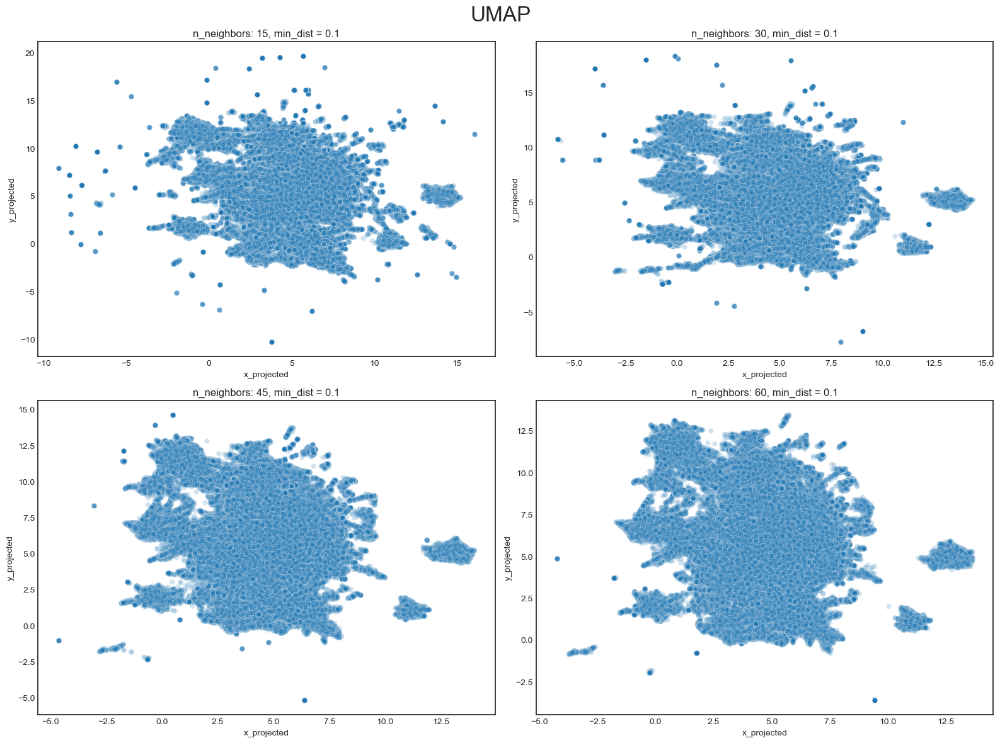

In [ ]:
fig, axes = plt.subplots(2,2, figsize = (16, 12))

df_umap = pd.DataFrame(mat_umap)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[0,0])
axes[0,0].set_xlabel("x_projected")
axes[0,0].set_ylabel("y_projected")
axes[0,0].set_title('n_neighbors: 15, min_dist = 0.1')


df_umap = pd.DataFrame(mat_umap_1)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[0,1])
axes[0,1].set_xlabel("x_projected")
axes[0,1].set_ylabel("y_projected")
axes[0,1].set_title('n_neighbors: 30, min_dist = 0.1')

df_umap = pd.DataFrame(mat_umap_2)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[1,0])
axes[1,0].set_xlabel("x_projected")
axes[1,0].set_ylabel("y_projected")
axes[1,0].set_title('n_neighbors: 45, min_dist = 0.1')

df_umap = pd.DataFrame(mat_umap_3)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[1,1])
axes[1,1].set_xlabel("x_projected")
axes[1,1].set_ylabel("y_projected")
axes[1,1].set_title('n_neighbors: 60, min_dist = 0.1')

fig.suptitle('UMAP Plot Set', fontsize = 24)

plt.tight_layout()
plt.show()

Select `n_neighbors = 45`,` min_dist = 0.1` as our representative UMAP plot.

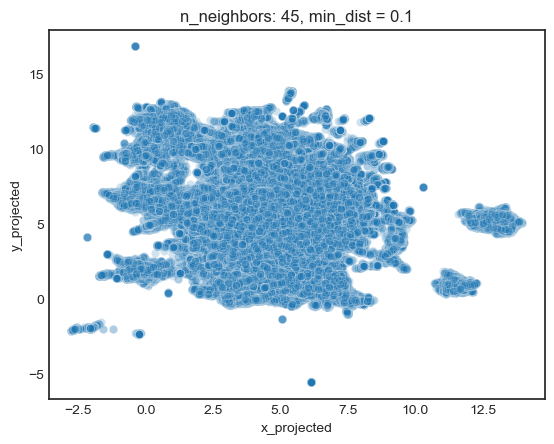

In [ ]:
fig, ax = plt.subplots(figsize=(6,4))
df_umap = pd.DataFrame(mat_umap_2)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2)
ax.set_xlabel("x_projected")
ax.set_ylabel("y_projected")
ax.set_title('n_neighbors: 45, min_dist = 0.1')
plt.show()

We see a main larger cluster surronded by 2 dense smaller clusters that are well-separated. None of their shape are convex and they are in different sparsities, additionally, for each cluster, the points are heavily stacked together. Directly applying clustering algorithms on the full dataset is impractical and unlikely to obtain ideal clustering results. We need to instead use sampled dataset that can represent the original data structure (i.e. similar 2d-reduced UMAP structure to the above plot). 

##### 6.1.1 Stratified Sampling

We implement the stratified sampling method to sample the reviews, by doing so, we prevent any distructed review rating structure caused by sampling. The general optimal (keep reviews as much as possible, and have a similar 2d-reduced UMAP structure at the same time) sample ratio we find is 0.3.    

In [72]:
df_sbert['rating'] = review_df_all_deduplicate['rating']

sample_ratio = 0.3

_, df_sbert_sample = train_test_split(df_sbert, test_size=sample_ratio, stratify=df_sbert['rating'], 
                                random_state=42)

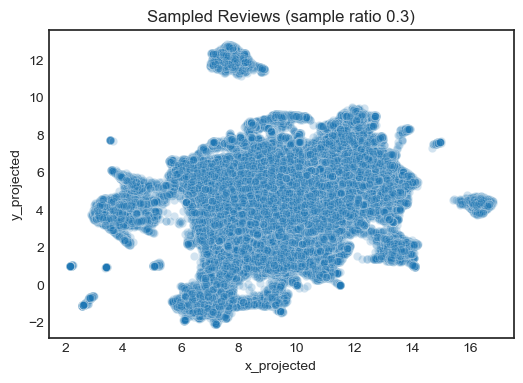

In [115]:
umap = UMAP(n_neighbors=45, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_cluster_sample_visual = umap.fit_transform(df_sbert_sample)

fig, ax = plt.subplots(figsize=(6,4))
df_umap_1 = pd.DataFrame(mat_umap_cluster_sample_visual)
sns.scatterplot(x=df_umap_1.iloc[:,0], y=df_umap_1.iloc[:,1], alpha = 0.2)
ax.set_xlabel("x_projected")
ax.set_ylabel("y_projected")
ax.set_title(f'Sampled Reviews (sample ratio {sample_ratio})')
plt.show()

##### 6.1.2 Dimensionality Reduction

Before implementing the clustering algorithm, to make the algorithm performing more efficiently, dimensionality reduction step is needed. The SBERT embedded vectors in 384-dimension are suffering 'curse of dimensionality', the distance between any 2 points converges and becomes nearly equidistant in the high dimensional space. By reducing dimensions to a latent space, UMAP concentrates the variance and re-establishes a meaningful distance metric, making it easier for algorithms to identify distinct boundaries.

Tuning the optimal UMAP reducing dimension needs vast computation resource, since this invovles the model fitting and post-metric evaluation. To make things simpler and concrete, we only use PCA (principal component number that contains 90% original data variance) to determine a near-optimal UMAP reducing dimension.

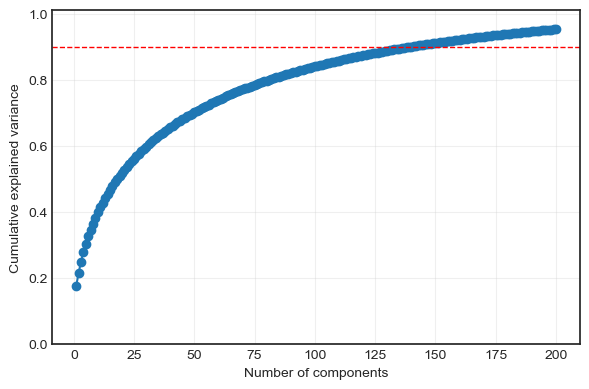

principal component number containing 90% variance:  140


In [116]:
mat_normalized = normalize(df_sbert_sample.to_numpy(), norm='l2')
pca = PCA(n_components=200, random_state= 42).fit(mat_normalized)
cumvar = np.cumsum(pca.explained_variance_ratio_)

plt.figure(figsize=(6,4))
plt.plot(range(1, len(cumvar)+1), cumvar, marker="o")
plt.axhline(0.9, color="r", ls="--", lw=1) 
plt.xlabel("Number of components")
plt.ylabel("Cumulative explained variance")
plt.ylim(0, 1.01)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

print('principal component number containing 90% variance: ',np.argmin(cumvar <= 0.9) + 1)

140 will be the value of UMAP `n_components`.

In [117]:
umap = UMAP(n_neighbors=45, min_dist = 0.1, n_components=140, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_cluster = umap.fit_transform(df_sbert_sample)

Plot 2D-visualization of the dimension-reduced sample reviews.

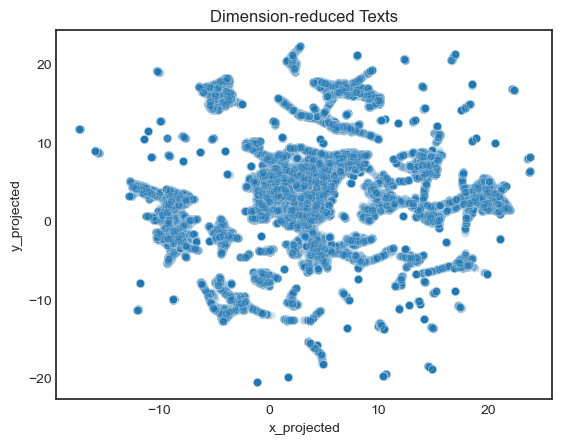

In [80]:
umap = UMAP(n_neighbors=45, min_dist = 0.1, n_components=2, init='pca', metric='cosine', n_jobs=-1, verbose=False)
mat_umap_cluster_visual = umap.fit_transform(mat_umap_cluster)

fig, ax = plt.subplots()
df_umap = pd.DataFrame(mat_umap_cluster_visual)
sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2)
ax.set_xlabel("x_projected")
ax.set_ylabel("y_projected")
ax.set_title('Dimension-reduced Texts')
plt.show()

The dimension-reduced reviews present a better clustering structure with non-convex clusters that are well-separated, and noise points scattered in the plot. DBSCAN is suited for our case, however, due to the large data size, we will be using HDBSCAN, which is significantly faster than traditional DBSCAN as data size increases.

### 6.2 HDBSCAN

We first set `min_samples` to 10, and tested 4 `min_cluster_size` values: 50, 150, 200, and 300, each parameter combination classifies near-to-half reviews to noise, and as `min_cluster_size` increasing, the algorithm tends to preserve global clustering structure, leading to fewer number of clusters, 

*e.g. `min_samples` = 5, `min_cluster_size` = 300:*

![pic](./hdbscan_pic/min_cluster_size_300_min_samples_10.jpg)

When `min_cluster_size` = 5, the algorithm only identified 4 clusters. Therefore, we tuned `min_cluster_size` to 200, leading to an appropriate number of clusters and not too focus on the local clustering at the same time. Then we tested `min_samples`: 5 and 15, the overall clustering results are similar, and smaller `min_samples` value leads to a slightly more distinct grouping result, so we tuned `min_cluster_size` to 5.

In [81]:
hdb = hdbscan.HDBSCAN(min_cluster_size= 200, min_samples=5, core_dist_n_jobs=-1)
hdb.fit(mat_umap_cluster)

HDBSCAN(core_dist_n_jobs=-1, min_cluster_size=200, min_samples=5)

In [82]:
labels = np.unique(hdb.labels_)
df_umap['cluster_label'] = hdb.labels_

for i in range(len(labels)):
    fig, ax = plt.subplots(figsize = (10, 8))
    sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], color = 'gray', alpha = 0.2, ax = ax)


    mask = df_umap['cluster_label'] == labels[i]
    sns.scatterplot(x=df_umap[mask].iloc[:,0], y=df_umap[mask].iloc[:,1], color = 'red', alpha = 0.5, ax = ax)
    ax.set_title(f'cluster label: {labels[i]}')
    plt.savefig(f'./pic/hdb_label_{labels[i]}.png')
    plt.close()

Below is the 2D-reduced UMAP plot color coded by each identified cluster. The algorithm identified 81 clusters, near-to-half reviews are still classified to noise, we discard them since they almost cover the whole clusters. And we manually assign some algorithm-identified clusters to one cluster, so that the final algorithm-identified clustering result meets our inherent clustering structure. 

![pic](./pic/hdbscan_pic/min_cluster_size_200_min_samples_5.jpg)

The final clustering result:

In [83]:
def show_pic(label, ax):
    label = label
    sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], color = 'gray', alpha = 0.2, ax = ax)
    
    mask = df_umap['cluster_label'].isin(label)
    sns.scatterplot(x=df_umap[mask].iloc[:,0], y=df_umap[mask].iloc[:,1], color = 'red', alpha = 0.5, ax = ax)
    ax.set_title(f'cluster label: {label}')
    ax.set_xlabel('')
    ax.set_ylabel('')

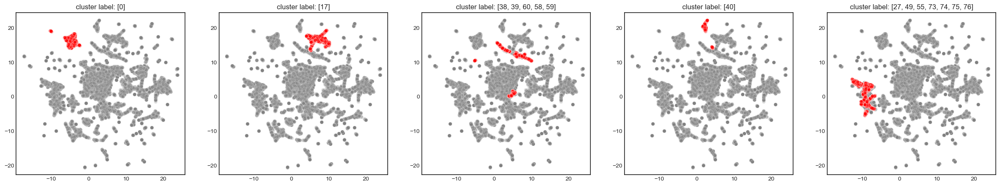

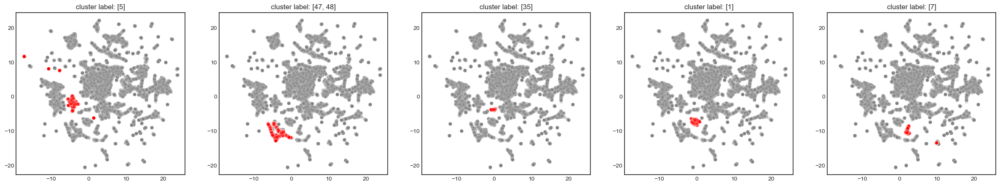

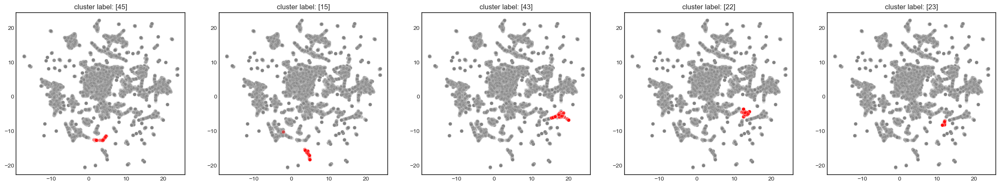

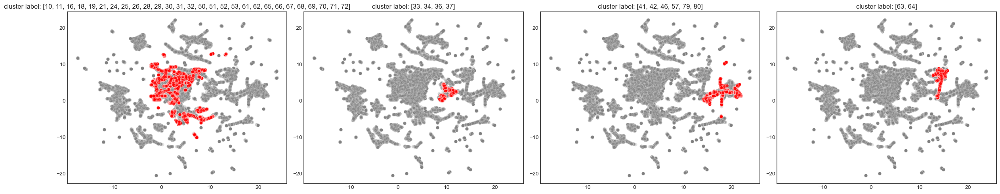

In [445]:
fig, axes = plt.subplots(1,5, figsize = (30, 5))

labels = [0]
show_pic(labels, axes[0])

labels = [17]
show_pic(labels, axes[1])

labels = [38, 39, 60, 58, 59]
show_pic(labels, axes[2])

labels = [40]
show_pic(labels, axes[3])

labels = [27, 49, 55, 73, 74, 75, 76]
show_pic(labels, axes[4])

fig, axes = plt.subplots(1,5, figsize = (30, 5))

labels = [5]
show_pic(labels, axes[0])

labels = [47, 48]
show_pic(labels, axes[1])

labels = [35]
show_pic(labels, axes[2])

labels = [1]
show_pic(labels, axes[3])

labels = [7]
show_pic(labels, axes[4])


fig, axes = plt.subplots(1,5, figsize = (30, 5))

labels = [45]
show_pic(labels, axes[0])

labels = [15]
show_pic(labels, axes[1])

labels = [43]
show_pic(labels, axes[2])

labels = [22]
show_pic(labels, axes[3])

labels = [23]
show_pic(labels, axes[4])

fig, axes = plt.subplots(1,5, figsize = (30, 5))

#labels = [33, 34, 36, 37, 41, 42, 44, 46, 54, 57, 63, 64, 77, 78, 79, 80]
#show_pic(labels, axes[0])

labels = [10, 11, 16, 18, 19, 21, 24, 25, 26, 28, 29, 30, 31, 32, 50, 51, 52, 53, 61, 62, 65, 66, 67, 68, 69, 70, 71, 72,]
show_pic(labels, axes[0])
axes[1].set_title('cluster label: [10, 11, 16, 18, 19, 21, 24, 25, 26, 28, 29, 30,...]')

labels = [33, 34, 36, 37]
show_pic(labels, axes[1])

labels = [41, 42, 46, 57, 79, 80]
show_pic(labels, axes[2])

labels = [63, 64]
show_pic(labels, axes[3])

for ax in axes[4:5].flatten():
    fig.delaxes(ax)

plt.tight_layout()

## 6.3 Post Clustering Analysis

Since we are clustering using only one pre-tuned parameter set (comparing the same metric values of differnt parameter sets is impractical given our limited computation resource), post-cluster metrics like calinski harabasz score and silhouette score are not useful. However, we can utilize the silhouette score plot to help evaluate clustering result by checking the shape of each cluster in the plot, and we also color code the 2D-reduced UMAP plot of full-dimension sample reivews and full-size reviews, to see whether the clustering structure obtained from dimension-reduced sample reviews remains well. 

In [2]:
df_result = pd.read_csv('./dataset/df_result.csv', index_col = 0)
df_result['new_cluster_label'] = (df_result['new_cluster_label'].map(lambda x: int(x) if pd.notna(x) else x).astype(str)
                                  .map(lambda x: x[:2] if len(x) == 4 else x[:1]))

The assigned cluster mapping: 

'0' ← 0, '1' ← [17], '2' ← [38, 39, 60, 58, 59], 

'3' ← [40], '4' ← [27, 49, 55, 73, 74, 75, 76], '5' ← [5], 

'6' ← [47, 48], '7' ← [35], '8' ← [1], 

'9' ← [7], '10' ← [45], '11' ← [15], 

'12' ← [43], '13' ← [22], '14' ← [23],  

'15' ← [10, 11, 16, 18, 19, 21, 24, 25, 26, 28, 29, 30, 31, 32, 50, 51, 52, 53, 61, 62, 65, 66, 67, 68, 69, 70, 71, 72], '16' ← [33, 34, 36, 37], '17' ← [41, 42, 46, 57, 79, 80], 

'18' ← [63, 64]

In [3]:
new_cluster_dict = {'0': [0], 
                    '1': [17],
                    '2': [38, 39, 60, 58, 59],
                    '3': [40],
                    '4': [27, 49, 55, 73, 74, 75, 76],
                    '5': [5],
                    '6': [47, 48],
                    '7': [35],
                    '8': [1],
                    '9': [7],
                    '10': [45],
                    '11': [15],
                    '12': [43],
                    '13': [22],
                    '14': [23], 
                    '15': [10, 11, 16, 18, 19, 21, 24, 25, 26, 28, 29, 30, 31, 32, 50, 51, 52, 53, 61, 62, 65, 66, 67, 68, 69, 70, 71, 72],
                    '16': [33, 34, 36, 37],
                    '17': [41, 42, 46, 57, 79, 80],
                    '18': [63, 64], 
                    '-1': [-1]}

def find_new_cluster_label(x):
    for k, v in new_cluster_dict.items():
        if x in v:
            return k
        

#df_result = review_df_all_deduplicate.loc[df_sbert_sample.index]
#df_result['hdb_cluster_label'] = hdb.labels_
#df_result['new_cluster_label'] = df_result['hdb_cluster_label'].map(find_new_cluster_label)

df_result = df_result[df_result['new_cluster_label'] != '-1']
df_result = df_result[df_result['new_cluster_label'].notna()]

df_result = df_result[df_result['new_cluster_label'] != 'n']

In [74]:
df_sbert_sample_effective = df_sbert_sample.loc[df_result.index]
df_sbert_sample_effective = df_sbert_sample_effective.iloc[:,:-1]
df_sbert_sample_effective['cluster_label'] = df_result['new_cluster_label']

Silhouette score plot:

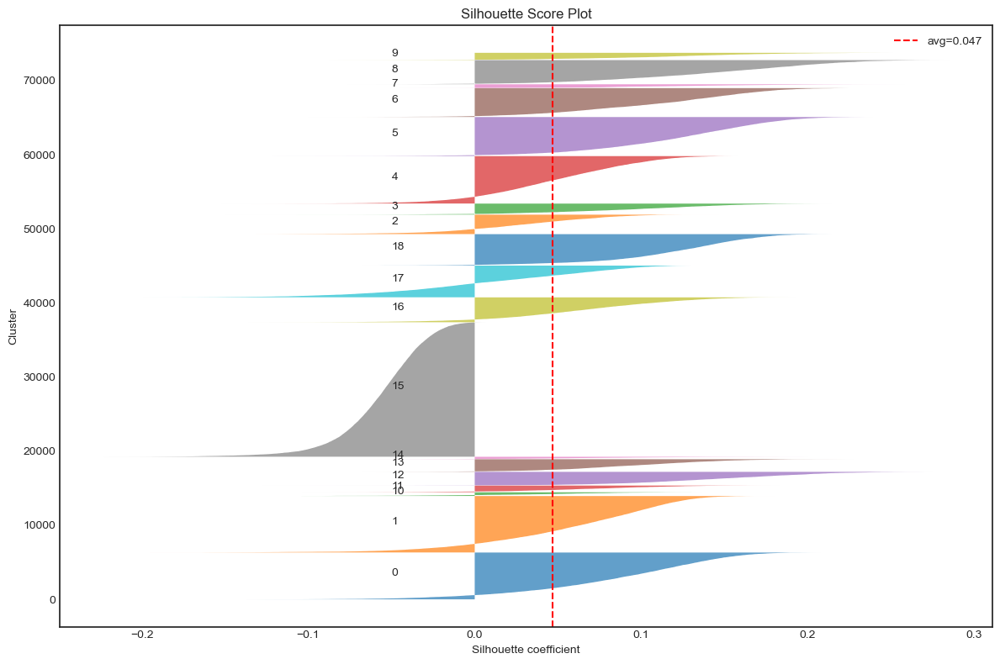

In [77]:
labels = np.ravel(df_sbert_sample_effective.iloc[:,-1:])
sil_vals = silhouette_samples(df_sbert_sample_effective.iloc[:,:-1], labels)
sil_avg = silhouette_score(df_sbert_sample_effective.iloc[:,:-1], labels)

y_lower = 10
plt.figure(figsize=(12, 8))

for i, c in enumerate(sorted(np.unique(labels))):
    cluster_sil = sil_vals[labels == c]
    cluster_sil.sort()
    size = cluster_sil.shape[0]
    y_upper = y_lower + size
    
    plt.fill_betweenx(np.arange(y_lower, y_upper), 0, cluster_sil, alpha=0.7)
    plt.text(-0.05, (y_lower + y_upper) / 2, str(c))
    y_lower = y_upper + 10

plt.axvline(x=sil_avg, color="red", linestyle="--", label=f"avg={sil_avg:.3f}")
plt.xlabel("Silhouette coefficient")
plt.ylabel("Cluster")
plt.title("Silhouette Score Plot")
plt.legend()
plt.tight_layout()
plt.show()

Based on the plot, we see that every cluster except the cluster 15 has a rough 'knife-like' shape and tails pointing to the left (negative value), meaning those tail points in the clusters are likely misclassified, this is rasonable since we are manually assigning reviews to create clusters, we couldn't avoid the noise points that the algorithm failed to identify. Since all the points in the cluster 15 have negative silhouette score, we discard this cluster even though it is intuitive to our eyes.

Color code on the 2D-dimension reduced sample reviews (full-dimension), all clusters:

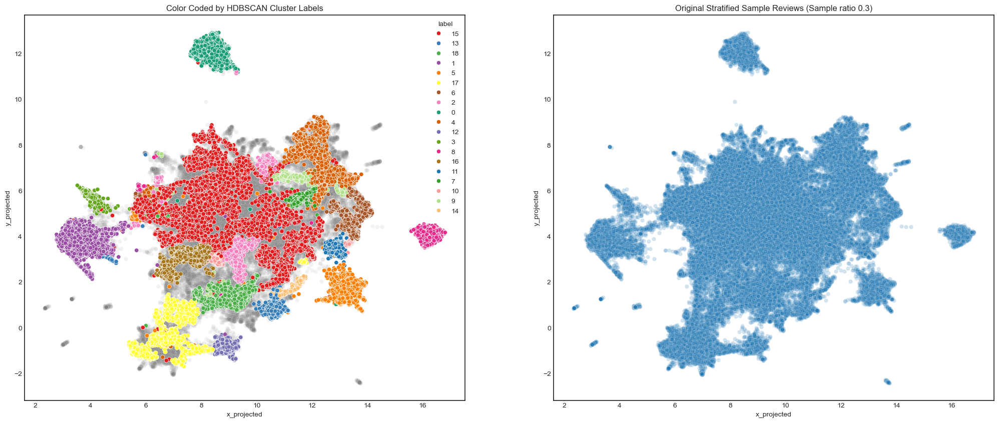

In [81]:
df_umap_1.index = df_sbert_sample.index
df_umap_1['label'] = None

df_umap_1.loc[df_result.index, 'label'] = df_result['new_cluster_label'].values

fig, axes = plt.subplots(1, 2, figsize = (25, 10))
sns.scatterplot(df_umap_1, x = 0, y = 1, color = 'grey', alpha = 0.1, ax = axes[0])
sns.scatterplot(df_umap_1, x = 0, y = 1, hue = 'label', ax = axes[0], 
                palette = [
    "#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00",
    "#ffff33", "#a65628", "#f781bf", "#1b9e77", "#d95f02",
    "#7570b3", "#66a61e", "#e7298a", "#a6761d", "#1f78b4",
    "#33a02c", "#fb9a99", "#b2df8a", "#fdbf6f"])

axes[0].set_title('Color Coded by HDBSCAN Cluster Labels')
axes[0].set_ylabel('y_projected')
axes[0].set_xlabel('x_projected')


sns.scatterplot(x=df_umap_1.iloc[:,0], y=df_umap_1.iloc[:,1], alpha = 0.2, ax = axes[1])
axes[1].set_xlabel("x_projected")
axes[1].set_ylabel("y_projected")
axes[1].set_title('Original Stratified Sample Reviews (Sample ratio 0.3)')

plt.show()



Without cluster 15:

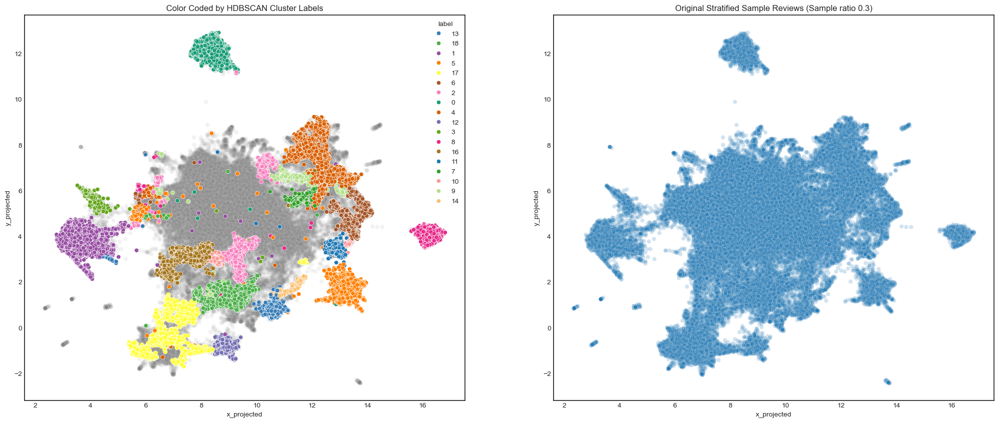

In [ ]:
df_umap_1.index = df_sbert_sample.index
df_umap_1['label'] = None

df_umap_1.loc[df_result.index, 'label'] = df_result['new_cluster_label'].values
df_umap_1 = df_umap_1[df_umap_1['label'] != '15']

fig, axes = plt.subplots(1, 2, figsize = (25, 10))
sns.scatterplot(df_umap_1, x = 0, y = 1, color = 'grey', alpha = 0.1, ax = axes[0])
sns.scatterplot(df_umap_1, x = 0, y = 1, hue = 'label', ax = axes[0], 
                palette = [
    "#377eb8", "#4daf4a", "#984ea3", "#ff7f00",
    "#ffff33", "#a65628", "#f781bf", "#1b9e77", "#d95f02",
    "#7570b3", "#66a61e", "#e7298a", "#a6761d", "#1f78b4",
    "#33a02c", "#fb9a99", "#b2df8a", "#fdbf6f"])

axes[0].set_title('Color Coded by HDBSCAN Cluster Labels')
axes[0].set_ylabel('y_projected')
axes[0].set_xlabel('x_projected')


sns.scatterplot(x=df_umap_1.iloc[:,0], y=df_umap_1.iloc[:,1], alpha = 0.2, ax = axes[1])
axes[1].set_xlabel("x_projected")
axes[1].set_ylabel("y_projected")
axes[1].set_title('Original Stratified Sample Reviews (Sample ratio 0.3)')

plt.show()


We can see the clusters except the cluster 15 are all cohesive and don't have intersection with the other clusters in general. Especially, the algorithm successfully identified the clear inherent clusters, which are the cluster 0, 1, 3, 5, and 8.

Color code on the 2D-dimension reduced full-size reviews (full-dimension), all clusters:

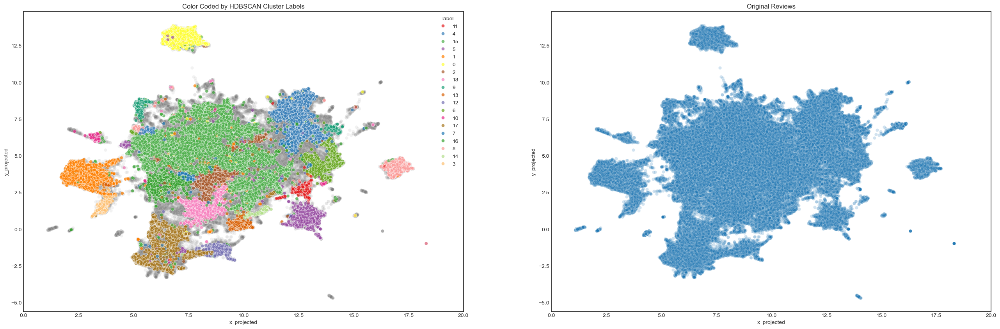

In [100]:
df_umap.index = df_sbert.index
df_umap['label'] = None

df_umap.loc[df_result.index, 'label'] = df_result['new_cluster_label'].values

fig, axes = plt.subplots(1, 2, figsize = (32, 10))
sns.scatterplot(df_umap, x = 0, y = 1, color = 'grey', alpha = 0.1, ax = axes[0])
sns.scatterplot(df_umap, x = 0, y = 1, hue = 'label',alpha = 0.7, ax = axes[0], 
                palette = [
    "#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00",
    "#ffff33", "#a65628", "#f781bf", "#1b9e77", "#d95f02",
    "#7570b3", "#66a61e", "#e7298a", "#a6761d", "#1f78b4",
    "#33a02c", "#fb9a99", "#b2df8a", "#fdbf6f"])

axes[0].set_title('Color Coded by HDBSCAN Cluster Labels')
axes[0].set_ylabel('y_projected')
axes[0].set_xlabel('x_projected')
axes[0].set_xlim([0, 20])

sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[1])
axes[1].set_xlabel("x_projected")
axes[1].set_xlim([0, 20])
axes[1].set_ylabel("y_projected")
axes[1].set_title('Original Reviews')

plt.show()

Without cluster 15:

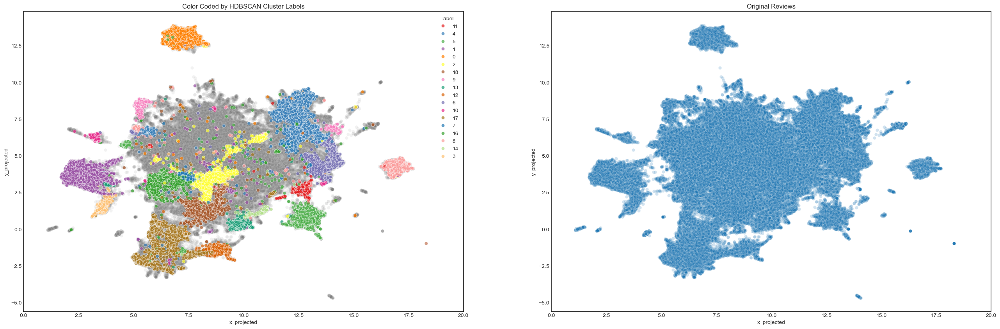

In [ ]:
df_umap = df_umap[df_umap['label'] != '15']

fig, axes = plt.subplots(1, 2, figsize = (32, 10))
sns.scatterplot(df_umap, x = 0, y = 1, color = 'grey', alpha = 0.1, ax = axes[0])
sns.scatterplot(df_umap, x = 0, y = 1, hue = 'label',alpha = 0.7, ax = axes[0], 
                palette = [
    "#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00",
    "#ffff33", "#a65628", "#f781bf", "#1b9e77", "#d95f02",
    "#7570b3", "#e7298a", "#a6761d", "#1f78b4",
    "#33a02c", "#fb9a99", "#b2df8a", "#fdbf6f"])

axes[0].set_title('Color Coded by HDBSCAN Cluster Labels')
axes[0].set_ylabel('y_projected')
axes[0].set_xlabel('x_projected')
axes[0].set_xlim([0, 20])

sns.scatterplot(x=df_umap.iloc[:,0], y=df_umap.iloc[:,1], alpha = 0.2, ax = axes[1])
axes[1].set_xlabel("x_projected")
axes[1].set_xlim([0, 20])
axes[1].set_ylabel("y_projected")
axes[1].set_title('Original Reviews')

plt.show()

The global clustering structure that we saw in the 2D-dimension reduced sample reviews remains on the full-size reviews in general.

# 7. Interpretate Result

Top 10 Most Comment Brands in Each Cluster:

In [4]:
df_result = df_result[df_result['new_cluster_label'] != '15']

df_plot = df_result.groupby(['new_cluster_label', 'brand_name']).agg({'brand_name': 'size'}).rename(columns = {'brand_name': 'count'}).sort_values(by = 'count', ascending = False).reset_index()
df_plot['parent'] = 'Top 10 Most Comment Brands in Each Cluster'

df_plot = df_plot.sort_values(['new_cluster_label', 'count'], ascending=[True, False])
df_plot['r'] = df_plot.groupby('new_cluster_label').cumcount() + 1
df_plot = df_plot[df_plot['r'] <= 10]

fig = px.treemap(df_plot, path=['parent', 'new_cluster_label', 'brand_name'], values='count')
fig.update_layout(
        width = 1200,
        height = 1000,
        margin = dict(l = 1, r = 1, t = 1, b = 1))
fig.update_traces(root_color="lightgrey")
fig.show()

In [97]:
df_summary = df_result.groupby('new_cluster_label').agg({'rating': 'mean', 'total_feedback_count': 'sum', 'author_id': 'nunique', 'review_text': 'count', 'price_usd': ['mean', 'min', 'max']})
df_summary.columns =  [f"{a}_{b}" for a, b in df_summary.columns]
df_summary = df_summary.rename(columns={'rating_mean': 'mean rating', 'total_feedback_count_sum': 'total customer past review','review_text_count': 'review count', 'price_usd_mean': 'mean price/unit', 'price_usd_min': 'min price/unit', 'price_usd_max': 'max price/unit'}).sort_values(by = ['mean rating', 'mean price/unit'], ascending = False)
df_summary['total customer past review/customer'] = df_summary['total customer past review'] / df_summary['author_id_nunique']
df_summary[['mean rating', 'review count', 'total customer past review/customer', 'mean price/unit', 'min price/unit', 'max price/unit']]

,mean rating,review count,total customer past review/customer,mean price/unit,min price/unit,max price/unit
new_cluster_label,,,,,,
14,4.739812,319,5.658147,93.544201,7.50,122.0
6,4.625739,3893,2.107552,48.624102,5.99,145.0
11,4.561384,896,3.521842,62.862143,3.50,125.0
2,4.541985,2620,3.282995,48.214740,3.00,380.0
18,4.540406,4232,2.817134,75.522474,3.50,449.0
5,4.492205,5260,4.071769,40.019329,3.50,225.0
12,4.465798,1842,7.246592,61.470917,6.50,425.0
8,4.461704,3251,4.179201,34.356666,7.00,380.0
16,4.456794,3356,1.441051,63.952887,5.99,425.0


In [22]:
print('overall cluster mean rating:', np.round(np.average(df_summary[['mean rating', 'review count', 'total customer past review/customer', 'mean price/unit']], axis = 0)[0], 4))
print('overall cluster review count:', np.round(np.average(df_summary[['mean rating', 'review count', 'total customer past review/customer', 'mean price/unit']], axis = 0)[1], 4))
print('overall cluster total customer past review/customer:', np.round(np.average(df_summary[['mean rating', 'review count', 'total customer past review/customer', 'mean price/unit']], axis = 0)[2], 4))
print('overall cluster mean price/unit:', np.round(np.average(df_summary[['mean rating', 'review count', 'total customer past review/customer', 'mean price/unit']], axis = 0)[3], 4))

overall cluster mean rating: 4.4179
overall cluster review count: 3079.0556
overall cluster total customer past review/customer: 3.8892
overall cluster mean price/unit: 50.6301


Combining the overall cluster mean rating and mean price/unit, the cluster 14, 11, 18, 12, and 16 are considered as the high quality groups, since they combine the customer satisfaction and total GMV.

Top 10 comment brands in these clusters:

- cluster 14: Sunday Riley, The Ordinary, Biossance, Drunk Elephant, Farmacy, Shani Darden Skin Care, Murad, MARA, Shiseido, Kiehl's Since 1851.

- cluster 11: Dr. Dennis Gross Skincare, goop, Peter Thomas Roth, Skinfix, The Ordinary, First Aid Beauty, Murad, alpyn beauty, SEPHORA COLLECTION, Wishful.

- cluster 18: Estée Lauder, fresh, Sulwhasoo, Glow Recipe, The INKEY List, Shiseido, Kiehl's Since 1851, bareMinerals, Clarins, Sunday Riley.

- cluster 12: Shani Darden Skin Care, Murad, The INKEY List, Kiehl's Since 1851, Drunk Elephant, Farmacy, Sunday Riley, Dermalogica, Josie Maran, Peter Thomas Roth.

- cluster 16: Estée Lauder, Tatcha, KORRES, belif, CLINIQUE, Drunk Elephant, Glow Recipe, goop, SK-II, Shiseido.

In [140]:
# product_df['first_secondary_category'] = product_df['primary_category'] + '_' + product_df['secondary_category'] + '_' + product_df['tertiary_category']

brands_list = [
    "alpyn beauty", "bareMinerals", "belif", "Biossance", "Clarins", 
    "CLINIQUE", "Dermalogica", "Dr. Dennis Gross Skincare", "Drunk Elephant", 
    "Estée Lauder", "Farmacy", "First Aid Beauty", "fresh", "Glow Recipe", 
    "goop", "Josie Maran", "Kiehl's Since 1851", "KORRES", "MARA", "Murad", 
    "Peter Thomas Roth", "SEPHORA COLLECTION", "Shani Darden Skin Care", 
    "Shiseido", "SK-II", "Skinfix", "Sulwhasoo", "Sunday Riley", "Tatcha", 
    "The INKEY List", "The Ordinary", "Wishful"
]

for brand in brands_list:
    mask = product_df['brand_name'] == brand
    if brand == 'alpyn beauty':
        dict_fin = dict(product_df[mask].groupby('first_secondary_category')['first_secondary_category'].agg('size'))

    else:
        dict_temp = dict(product_df[mask].groupby('first_secondary_category')['first_secondary_category'].agg('size'))
        for k, v in dict_temp.items():
            if dict_fin.get(k) is None:
                dict_fin[k] = v
            else:
                dict_fin[k] += v

df_summary = pd.DataFrame(dict_fin.values(), index= dict_fin.keys()).sort_values(by = 0, ascending=False).rename(columns = {0: 'count'})[:20]
df_summary['proportion'] = np.round(df_summary['count'] * 100/ df_summary['count'].sum(), 3).astype(str) + '%'
df_summary.index.name = 'High quality group'
df_summary

,count,proportion
High quality group,,
Skincare_Treatments_Face Serums,184,18.872%
Skincare_Moisturizers_Moisturizers,170,17.436%
Skincare_Cleansers_Face Wash & Cleansers,104,10.667%
Skincare_Eye Care_Eye Creams & Treatments,75,7.692%
Skincare_Masks_Face Masks,58,5.949%
Bath & Body_Body Moisturizers_Body Lotions & Body Oils,42,4.308%
Skincare_Sunscreen_Face Sunscreen,38,3.897%
Skincare_Moisturizers_Face Oils,37,3.795%
Skincare_Cleansers_Toners,35,3.59%


Take a closer look to the tertiary category of the products of these brands, Face Serums, Moisturizers, Face Wash & Cleansers, and Eye Creams & Treatments account for top proportion in skincare, while Toners, Face Oils, and Face Brushes makeups are the top in makeup.

Compared to the high quality groups, cluster 3, 10, 0, 1 and 4 are the low quality groups.

cluster 3: St. Tropez, Isle of Paradise, Dr. Jart+, Drunk Elephant, TAN-LUXE, Supergoop!, WASO, IT Cosmetics, The Ordinary, Sunday Riley

cluster 10: goop (most proportion)

cluster 0: LANEIGE, fresh, belif, Tatcha, SEPHORA COLLECTION, Glow Recipe, Summer Fridays, Fenty Skin, Dr. Lara Devgan, Sol de Janeiro

cluster 1: Supergoop!, Shiseido, Dr. Jart+, Peter Thomas Roth, Glow Recipe, Murad, innisfree, Biossance, Drunk Elephant, Nécessaire

cluster 4: Farmacy, The INKEY List, Youth To The People, Tatcha, CLINIQUE, Dermalogica, Drunk Elephant, Glow Recipe, fresh, belif

In [141]:
brands_list = [
    "belif", "Biossance", "CLINIQUE", "Dermalogica", "Dr. Jart+", 
    "Dr. Lara Devgan", "Drunk Elephant", "Farmacy", "Fenty Skin", "fresh", 
    "Glow Recipe", "goop", "innisfree", "Isle of Paradise", "IT Cosmetics", 
    "LANEIGE", "Murad", "Nécessaire", "Peter Thomas Roth", "SEPHORA COLLECTION", 
    "Shiseido", "Sol de Janeiro", "St. Tropez", "Summer Fridays", "Sunday Riley", 
    "Supergoop!", "TAN-LUXE", "Tatcha", "The INKEY List", "The Ordinary", 
    "WASO", "Youth To The People"
]

for brand in brands_list:
    mask = product_df['brand_name'] == brand
    if brand == 'alpyn beauty':
        dict_fin = dict(product_df[mask].groupby('first_secondary_category')['first_secondary_category'].agg('size'))

    else:
        dict_temp = dict(product_df[mask].groupby('first_secondary_category')['first_secondary_category'].agg('size'))
        for k, v in dict_temp.items():
            if dict_fin.get(k) is None:
                dict_fin[k] = v
            else:
                dict_fin[k] += v

df_summary = pd.DataFrame(dict_fin.values(), index= dict_fin.keys()).sort_values(by = 0, ascending=False).rename(columns = {0: 'count'})[:20]
df_summary['proportion'] = np.round(df_summary['count'] * 100/ df_summary['count'].sum(), 3).astype(str) + '%'
df_summary.index.name = 'Low quality group'
df_summary

,count,proportion
Low quality group,,
Skincare_Treatments_Face Serums,340,18.309%
Skincare_Moisturizers_Moisturizers,307,16.532%
Skincare_Cleansers_Face Wash & Cleansers,192,10.339%
Skincare_Eye Care_Eye Creams & Treatments,138,7.431%
Skincare_Masks_Face Masks,121,6.516%
Skincare_Sunscreen_Face Sunscreen,95,5.116%
Bath & Body_Body Moisturizers_Body Lotions & Body Oils,87,4.685%
Skincare_Cleansers_Toners,71,3.823%
Skincare_Moisturizers_Face Oils,61,3.285%


Comapare these two groups, the proportion of top tertiary category of skincare in high quality group is higher than in the low quality group (particularly Face Serums, Moisturizers and Face Oils), while Toners, Sheet Masks and Eye_Eyeliner account for higher proportion in the low quality group. The high quality group has hihger proportion of Face_Foundation, Face Primer and lower proportion of Face Brushes, Eyeliner, Eye Brushes. 

## High Quality Group Grams

In [9]:
def top_grams(cluster_list, gram_num):

    if gram_num == 2:
        print('Bi-grams:')
        print("-" * 60)

    if gram_num == 3:
        print('Tri-grams:')
        print("-" * 60)
        
    for cluster in cluster_list:
        df_cluster = df_result[df_result['new_cluster_label'] == cluster]
        combined_text = " ".join(df_cluster['review_text_cleaned'].tolist())
        
        ngrams_list = generate_ngrams(combined_text, n_gram=2)
        top_keywords = Counter(ngrams_list).most_common(10)
        
        print(f"Cluster {cluster} (Size: {len(df_cluster)})")
        print(f"Top Keywords: {top_keywords}", '\n')
        print("-" * 60)

def create_word_cloud(cluster_list, gran_num):
    n_clusters = len(cluster_list)
    n_cols = 4
    n_rows = math.ceil(n_clusters / n_cols)
    
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, n_rows * 4))
    axes = axes.flatten() 
    
    for i, cluster_id in enumerate(cluster_list):
        ax = axes[i]
        cluster_data = df_result[df_result['new_cluster_label'] == cluster_id]
        
        combined_text = " ".join(cluster_data['review_text_cleaned'].astype(str).tolist())
        ngrams_list = generate_ngrams(combined_text, n_gram=gran_num)
        ngram_counts = dict(Counter(ngrams_list).most_common(100))
        
        if len(ngram_counts) > 0:
            wc = WordCloud(width=800, height=400, background_color='white', colormap='viridis', 
            max_font_size=100).generate_from_frequencies(ngram_counts)
            
            ax.imshow(wc, interpolation="bilinear")
            ax.set_title(f"Cluster {cluster_id} Theme\n(Size: {len(cluster_data)})", fontsize=14)
            
        else:
            ax.text(0.5, 0.5, "Not enough data", ha='center', va='center')
        
        ax.axis('off') 
        
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
        
    plt.tight_layout()
    plt.show()

Bi-grams:
------------------------------------------------------------
Cluster 14 (Size: 319)
Top Keywords: [('sunday riley', 316), ('good genes', 203), ('lactic acid', 194), ('complimentary sunday', 74), ('riley good', 70), ('gifted sunday', 67), ('acid treatment', 66), ('fine lines', 52), ('one lactic', 46), ('genes one', 37)] 

------------------------------------------------------------
Cluster 11 (Size: 896)
Top Keywords: [('daily peel', 132), ('doctor dennis', 127), ('dennis gross', 121), ('sensitive skin', 120), ('extra strength', 105), ('alpha beta', 100), ('strength daily', 96), ('beta extra', 90), ('glycolic acid', 86), ('glow peel', 68)] 

------------------------------------------------------------
Cluster 18 (Size: 4232)
Top Keywords: [('love serum', 489), ('anti aging', 324), ('skin feel', 315), ('using serum', 306), ('skin feels', 295), ('makes skin', 273), ('sensitive skin', 260), ('leaves skin', 222), ('skin feeling', 212), ('fine lines', 207)] 

----------------------

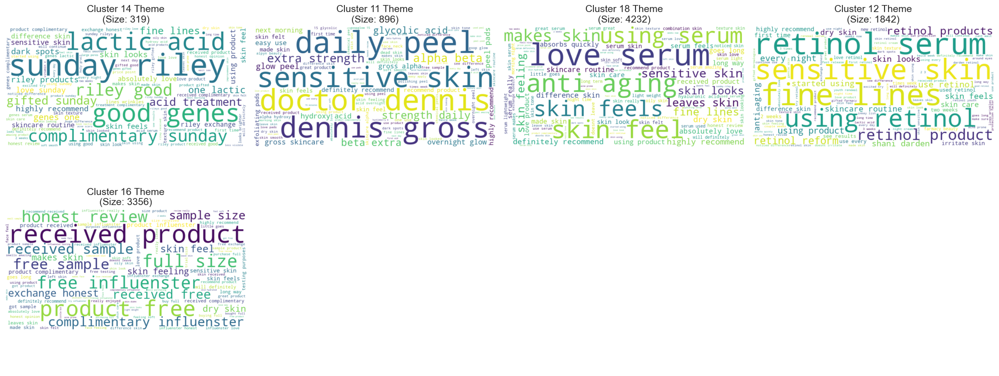

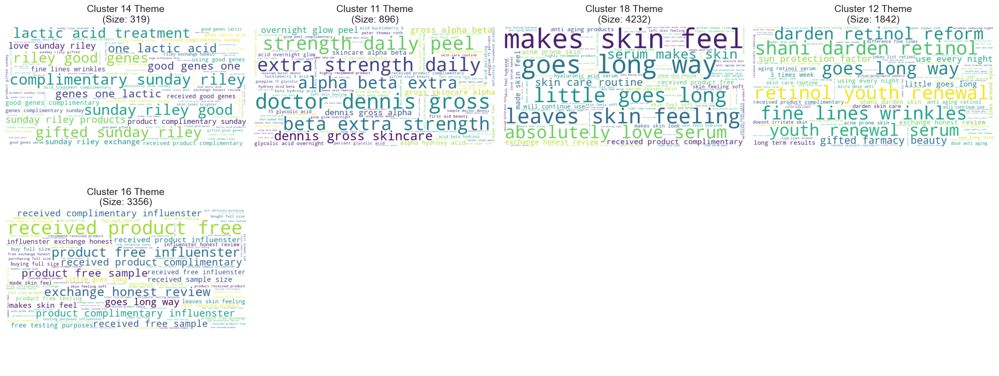

In [10]:
clusters = ['14', '11', '18', '12', '16']
top_grams(clusters, 2)
top_grams(clusters, 3)

create_word_cloud(clusters, 2)
create_word_cloud(clusters, 3)

The topic of cluster 3 mainly concentrates on sunday riley products, customers are particularly talking about the acid component related to the products and are showing postive feedback after trying lactic acid treatment.

The topic of cluster 11 mainly concentrates on Dr. dennis daily peel products, particularly the alpha beta daily peel. Acid components are also the central point that the customers care about, they espcially like the glycolic acid, hydroxy acid and alpha hydroxy acid.

The topic of cluster 18 mainly concentrates on the face serum, customers are satisfactory about the anti aging effect of the products.

The topic of cluster 12 mainly concentrates on the retinol serum, which is a sub-category of the face serum, and the brand is mainly related to shani darden retinol, customers are also satisfactory about the anti aging effect of the products.

The comments from cluster 16 are mainly about the feedback after receiving the sample products from influenster, the products related to this channel seem to have a higher rating and to contribute more to GMV.

## Low Quality Group Grams

Bi-grams:
------------------------------------------------------------
Cluster 3 (Size: 1482)
Top Keywords: [('self tanner', 378), ('st tropez', 197), ('self tanning', 147), ('self tanners', 134), ('easy apply', 104), ('self tan', 104), ('easy use', 99), ('natural looking', 87), ('skin tone', 84), ('tanning drops', 84)] 

------------------------------------------------------------
Cluster 10 (Size: 497)
Top Keywords: [('morning skin', 108), ('goopglow morning', 84), ('skin superpowder', 70), ('goop glow', 58), ('received product', 55), ('5 days', 46), ('vitamin c', 44), ('product complimentary', 39), ('complimentary goop', 36), ('difference skin', 35)] 

------------------------------------------------------------
Cluster 0 (Size: 6316)
Top Keywords: [('lip balm', 1839), ('lip mask', 1220), ('dry lips', 574), ('lips feel', 526), ('makes lips', 439), ('lip balms', 371), ('chapped lips', 350), ('love lip', 337), ('lips soft', 336), ('leaves lips', 297)] 

-------------------------------

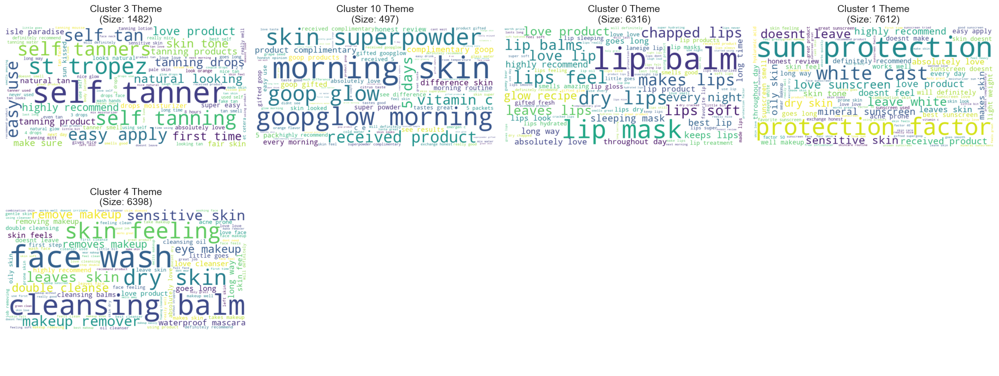

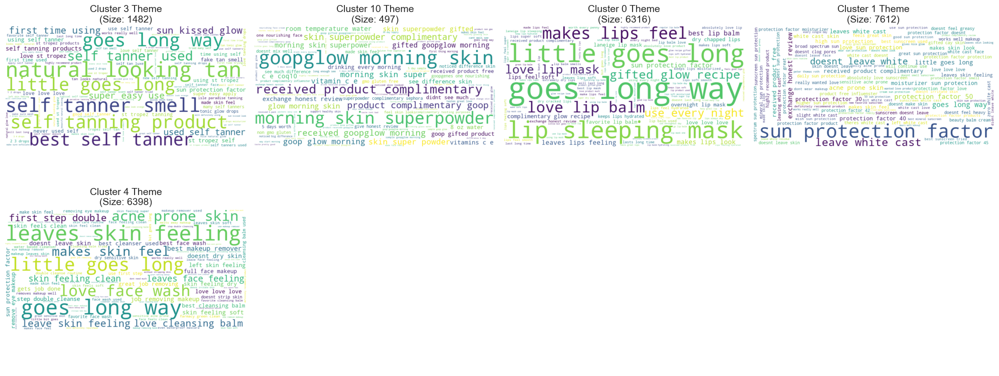

In [11]:
clusters = ['3', '10', '0', '1', '4']
top_grams(clusters, 2)
top_grams(clusters, 3)

create_word_cloud(clusters, 2)
create_word_cloud(clusters, 3)

The topic of cluster 3 mainly concentrates on the tanner, and the brand is particularly about St.Tropez. The primary cause for the low rating might be the first time using, fake smell, and sun-protection factor of the product based on the cluster top frequent tri-grams.

The topic of cluster 10 mainly concentrates on the skin superpowder, and the product type is particularly goop complimentary sample. The coustomers are not satisfactory about the goop sample products, the potential cause might be the vitamins in the product and effect of the product (not seeing much difference).

The topic of cluster 0 mainly concentrates on the lip-related products, and the product type is particularly glow receipe complimentary sample.

The topic of cluster 1 mainly concentrates on the sun protection products, the customers are mainly talking about the white cast face, and sensitive skin, oily skin, and acne prone skin are usually mentioned.

The topic of cluster 4 mainly concentrates on the cleansing balm.

Customer profile

In [12]:
def plot_profile(profile):
    df_result_profile = df_result[(df_result[['skin_tone', 'eye_color', 'skin_type', 'hair_color']] != 'No_profile').all(axis = 1)]
    df_plot = pd.DataFrame(df_result_profile.groupby('new_cluster_label')[profile].value_counts()).reset_index()

    fig = px.bar(df_plot, x = 'new_cluster_label', y = 'count', color=profile, title=profile)
    fig.update_layout(
        width = 1000,
        height = 500,
        margin = dict(l = 1, r = 1, t = 30, b = 1))
    fig.show()

In [13]:
plot_profile('skin_tone')
plot_profile('eye_color')
plot_profile('skin_type')
plot_profile('hair_color')